# <font color='red'>Importing libraries</font>

In [1]:
# Math, image processing and other useful libraries
from __future__ import print_function, unicode_literals, absolute_import, division
import os
import pandas as pd
import numpy as np
import cv2
from collections import OrderedDict
import copy
import math
import pickle
from matplotlib.ticker import MaxNLocator
from itertools import combinations

# Image processing
from skimage.measure import regionprops
from skimage.filters import meijering, sato, frangi, hessian, threshold_otsu
from skimage.morphology import extrema, skeletonize
from skimage.transform import probabilistic_hough_line
from skimage.draw import disk, circle_perimeter
from scipy.ndimage import gaussian_filter, grey_closing
from scipy.spatial import distance_matrix
from skimage import data, restoration, util
from roipoly import RoiPoly
from matplotlib_scalebar.scalebar import ScaleBar
from biosppy.signals import tools
from biosppy.stats import pearson_correlation
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Plotting
import matplotlib.pyplot as plt
import matplotlib.cm as pltc
import matplotlib.colors as colors
import seaborn as sns

# Widgets
import ipywidgets as widgets
from ipywidgets import interact, interactive, fixed, interact_manual
from IPython.display import display

# Feature Extraction (.py files by Teresa Parreira)
# from CytoSkeletonPropsMorph import CytoSkeletonPropsMorph
# from CytoSkeletonRegionPropsInt import RegionPropsInt
# from FreqAnalysis import FreqAnalysis
# from GLCM import GLCM

# Graph
import sknw
import networkx as nx
from scipy.signal import argrelextrema

# 
from skan import Skeleton, summarize,draw
from skan.csr import skeleton_to_csgraph, sholl_analysis,make_degree_image
import scipy as sp
import scipy.sparse
from matplotlib.patches import Circle
from ImageFeatures import ImageFeatures
from Functions import label_image, FeaturesFromCentroid, cv2toski,pylsdtoski,init_import,polar_to_cartesian, truncate_colormap, plot_hist, plot_pie, remove_not1D, quantitative_analysis,hist_bin,hist_lim,create_separate_DFs,getAAI,Others,branch,graphAnalysis,sholl
from fractal_dimension import fractal_dimension
from fractal_analysis_fxns import boxcount,boxcount_grayscale,fractal_dimension,fractal_dimension_grayscale,fractal_dimension_grayscale_DBC

print('📚')

C:\Users\diogo\AppData\Roaming\Python\Python37\site-packages\nose\importer.py:12: DeprecationWarning: the imp module is deprecated in favour of importlib; see the module's documentation for alternative uses
  from imp import find_module, load_module, acquire_lock, release_lock


📚


# <font color='red'>Import and Create DataFrame with available images</font>

In [2]:
global OriginalDF,DeconvDF,DenoisedDF,NoiseDF,NucleiDeconvDF,SyntheticDF
OriginalDF,DeconvDF,DenoisedDF,NoiseDF,NucleiDeconvDF,SyntheticDF = init_import()  # Import Images, add to DataFrame
Centroids = pickle.load(open('Centroids.p', 'rb'))
TextureDF = pd.read_pickle(os.getcwd() + "\\TextureDF.pkl")   
dir_masks = os.getcwd() + str("//nuclei_masks")
ROIs      = pickle.load(open('ROIs.p', 'rb'))

print('🌠')

🌠


In [14]:
#OriginalDF
#DeconvDF
#DenoisedDF
#NoiseDF
#NucleiDeconvDF
#Centroids
TextureDF

,Name,Index,Label,Skeleton
11,10_6IF_CHO_L_w3_(DAPI+Alexa 568)_PS.tif,11,WT,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
16,15_IF6_CHO_L-W1_(DAPI+Alexa 568)_PS.tif,16,Mock,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
18,17_IF6_CHO_L-W1_(DAPI+Alexa 568)_PS.tif,18,Mock,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
20,19_IF6_CHO_L-W1_(DAPI+Alexa 568)_PS.tif,20,Mock,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
34,33_IF6_CHO_L-W5_(DAPI+Alexa 568)_PS.tif,34,No transfection,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
36,35_IF6_CHO_L-W5_(DAPI+Alexa 568)_PS.tif,36,No transfection,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
38,37_IF6_CHO_L-W5_(DAPI+Alexa 568)_PS.tif,38,No transfection,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
40,39_IF6_CHO_L-W6_(DAPI+Alexa 568)_PS.tif,40,Del38_46,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
42,41_IF6_CHO_L-W6_(DAPI+Alexa 568)_PS.tif,42,Del38_46,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."
44,43_IF6_CHO_L-W6_(DAPI+Alexa 568)_PS.tif,44,Del38_46,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,..."


# <font color='red'>Analyze Nuclei</font>

In [7]:
def analyze_nuclei(Centroids,NucleiDeconvDF,plot):
    ids  = list(DeconvDF.index)
    try:
        ids.remove('S1')
    except:
        pass
    
    for ind in ids:
        df      = Centroids[ind]
        nuc_img = NucleiDeconvDF.loc[ind]['Image'] / np.max(NucleiDeconvDF.loc[ind]['Image'])
        
        global bin_nuclei,ext,patch_n
        for index,row in df.iterrows():
            try:
                bin_nuclei = np.where(row['Mask With ID']>0.5, 1, 0)
                nuclei     = bin_nuclei * nuc_img
                nuclei     = nuclei / np.max(nuclei)

                # Patch
                global contourr,cr
                contourr = row['Contour'][0]
                cr       = contourr.reshape((contourr.shape[0],contourr.shape[2]))
                patch_n  = nuclei[min(cr[:,1]):max(cr[:,1]),min(cr[:,0]):max(cr[:,0])]

                # Check limits
                ext = [min(cr[:,1]),max(cr[:,1]),min(cr[:,0]),max(cr[:,0])]
                #print(ext)
                if 0 in ext or 1 in ext or 1040 in ext or 1039 in ext or 1388 in ext or 1387 in ext:
                    continue


                # PROCESSING
                # Features Teresa
                feats_all_n                      = ImageFeatures(((patch_n / np.max(patch_n))*255).astype(np.uint8))
                feats_labels_n_, feats_values_n_ = feats_all_n.print_features(print_values = False)

                #return feats_labels_n_, feats_values_n_
                feats_labels_n_, feats_values_n_ = remove_not1D(feats_labels_n_,feats_values_n_)
                feats_labels_n_                  = ['DNF:' + ftn for ftn in feats_labels_n_]

                # Fractal Dimension
                fd = fractal_dimension(patch_n)
                #fractal_values_n_b = [round(b_n)]
                #fractal_values_n_d = [round(d_n)] 


                if plot:
                    fig, ax = plt.subplots(); fig.figsize = (15,15)
                    ax.imshow(np.zeros_like(nuclei),cmap='gray')  
                    ax.imshow(nuclei,cmap='gray')
                    #ax.plot(cr[:,0],cr[:,1],'--',color='#6495ED',zorder=11,linewidth=2.5)
                    #ax.plot(row['Centroid'][1],row['Centroid'][0],'o',color='#6495ED',markersize=8,zorder=8)
                    ax.axis('off')
                    ax.set_ylim([min(cr[:,1]),max(cr[:,1])])
                    ax.set_xlim([min(cr[:,0]),max(cr[:,0])])
                    plt.savefig(".//NucleiSofia//img_" + str(ind) + "_id_"  + str(index) + ".png",format='png',transparent=True,bbox_inches='tight',dpi=200)
                    plt.show()

                global ImageLinesDF
                if 'ImageLinesDF' not in globals():
                        #ImageLinesDF = pd.DataFrame(columns = ['Name'] + ['Img Index'] + ['Label'] + ['Mask'] + ['Patches'] + ['Lines'] + ['Graph'] + ['LSF2D:Angles'] + ['LSF2D:Distances to Centroid'] + ['LSF2D:Triangle Areas'] + ['LSF2D:Line Lengths'] + ['LSF2D:Theta'] + ['LSF2D:Angle Difference'] + ['LSF2D:Std. Angle Difference'] + ['LSF2D:Local Line Distance'] + ['LSF2D:Std. Local Line Distance'] + ['LSF1D:Number of Lines'] + ['LSF1D:Radial Score'] + ['DCF:AAI'] + ['DCF:Fractal Dim'] + list(feats_morph_labels) + list(feats_int_labels) + list(glcm_labels) + list(freqs_labels) + ['DNF:Nuclei Fractal Dim'] + list(feats_morph_labels_n) + list(feats_int_labels_n) + list(glcm_labels_n) + list(freqs_labels_n) + [graph_ft for graph_ft in list(zip(*graph_res))[0]])
                        ImageLinesDF = pd.DataFrame(columns = ['Name'] + ['Img Index'] + ['Label'] + ['Mask'] + ['Patches'] + ['Fractal Dimension'] + list(feats_labels_n_))

                new          = pd.Series([NucleiDeconvDF.loc[ind]['Name']] + [ind] + [NucleiDeconvDF.loc[ind]['Label']] + [row['Mask With ID']] + [[patch_n]] + [fd] + feats_values_n_ ,index=ImageLinesDF.columns)
                ImageLinesDF = ImageLinesDF.append(new,ignore_index=True)
            except:
                print('error,',ind,",",index)
                pass

    return ImageLinesDF

print('FUNCTION: analyze_nuclei')

FUNCTION: analyze_nuclei


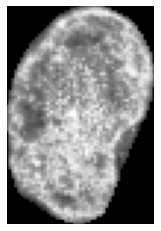

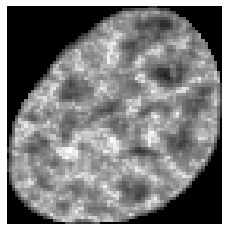

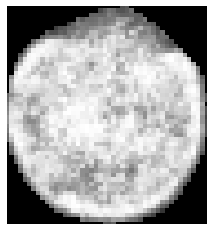

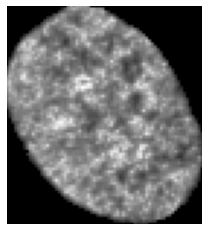

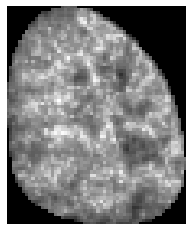

...

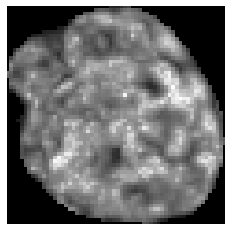

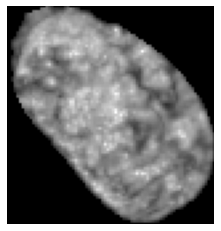

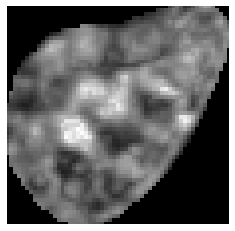

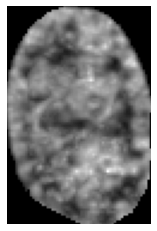

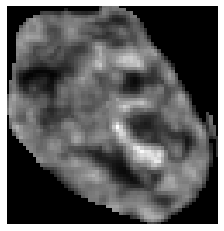

spectral.py (1966): nperseg = 256 is greater than input length  = 97, using nperseg = 97


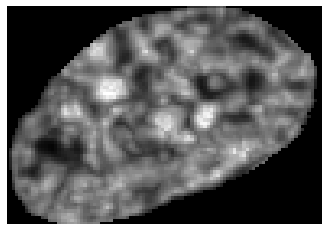

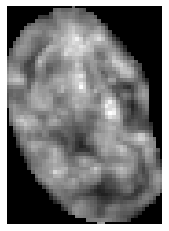

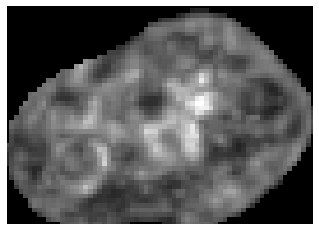

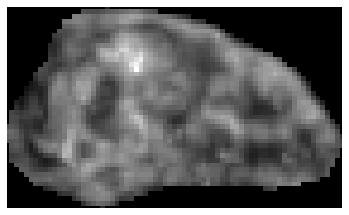

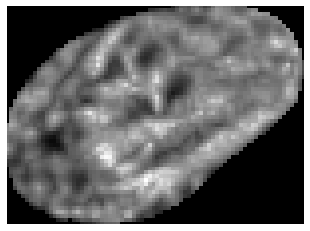

spectral.py (1966): nperseg = 256 is greater than input length  = 85, using nperseg = 85


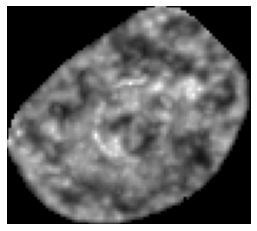

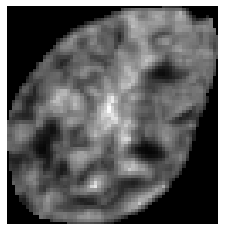

spectral.py (1966): nperseg = 256 is greater than input length  = 58, using nperseg = 58


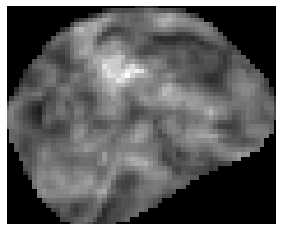

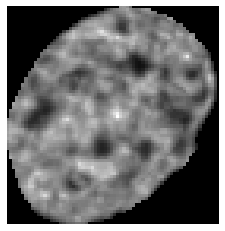

spectral.py (1966): nperseg = 256 is greater than input length  = 91, using nperseg = 91


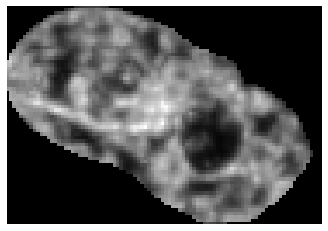

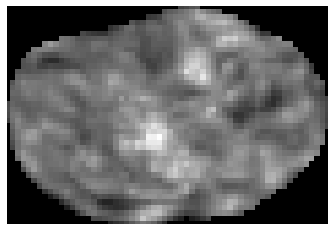

spectral.py (1966): nperseg = 256 is greater than input length  = 84, using nperseg = 84


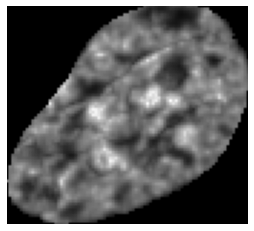

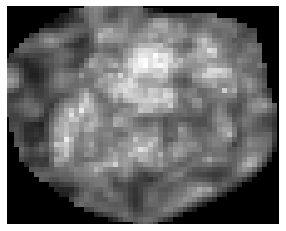

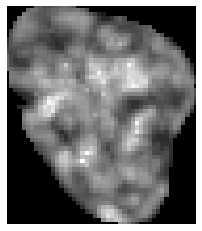

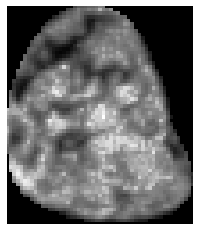

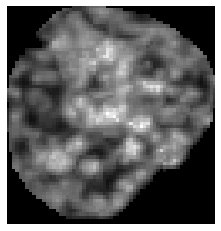

...

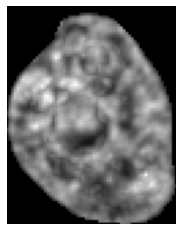

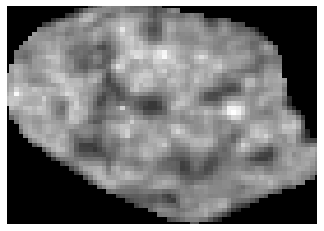

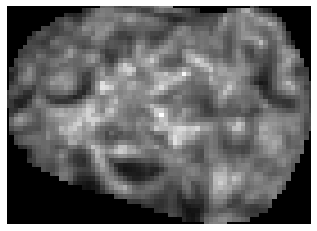

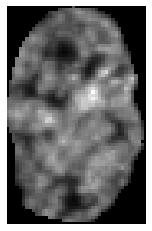

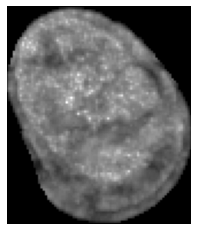

spectral.py (1966): nperseg = 256 is greater than input length  = 74, using nperseg = 74


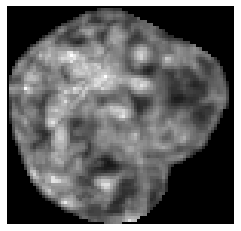

spectral.py (1966): nperseg = 256 is greater than input length  = 51, using nperseg = 51


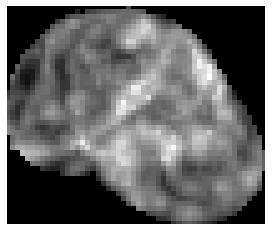

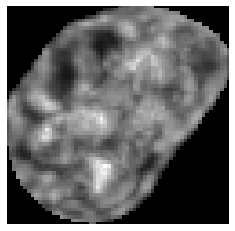

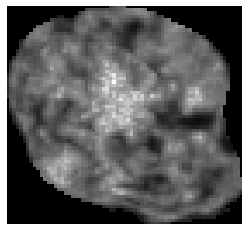

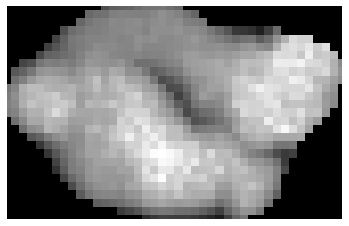

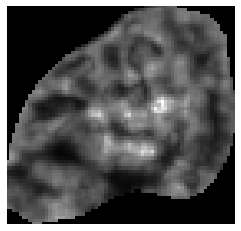

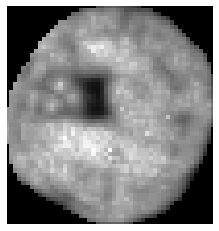

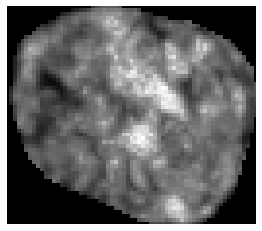

spectral.py (1966): nperseg = 256 is greater than input length  = 35, using nperseg = 35


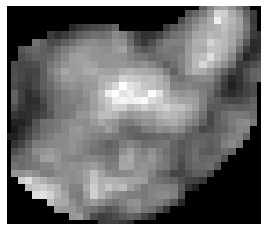

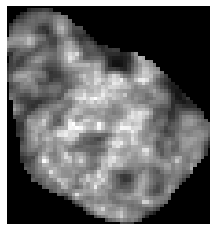

spectral.py (1966): nperseg = 256 is greater than input length  = 37, using nperseg = 37


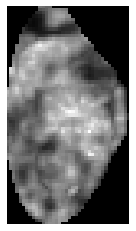

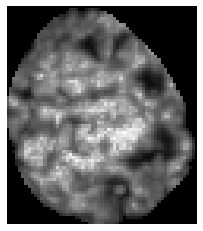

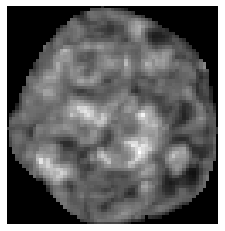

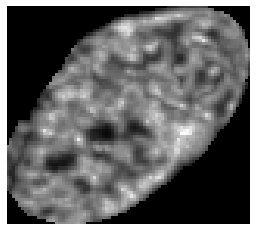

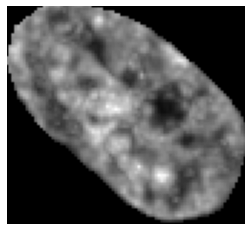

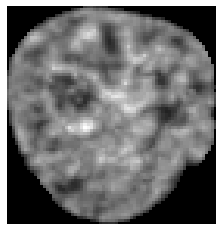

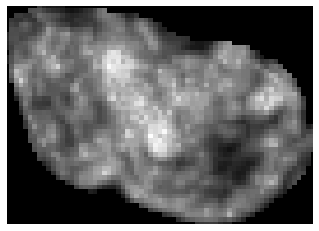

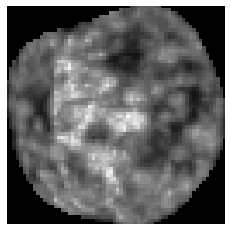

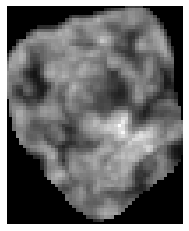

spectral.py (1966): nperseg = 256 is greater than input length  = 43, using nperseg = 43


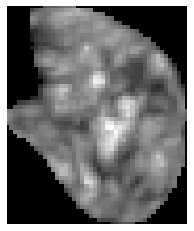

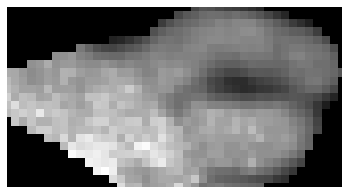

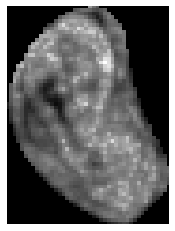

spectral.py (1966): nperseg = 256 is greater than input length  = 86, using nperseg = 86


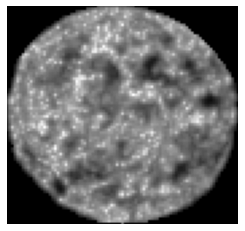

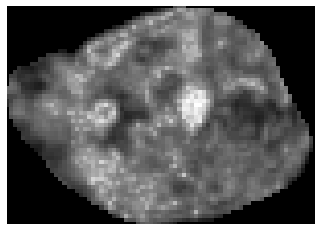

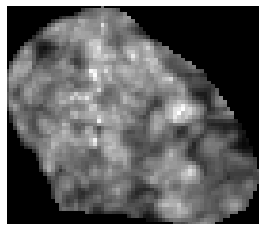

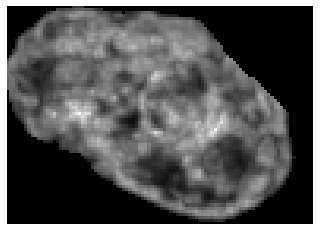

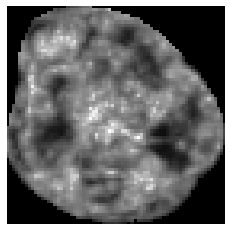

spectral.py (1966): nperseg = 256 is greater than input length  = 34, using nperseg = 34


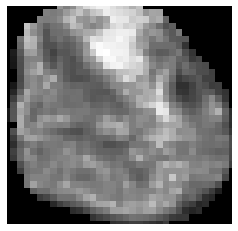

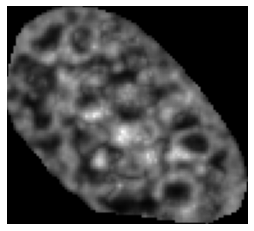

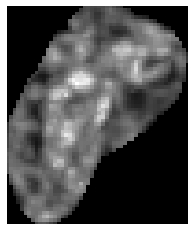

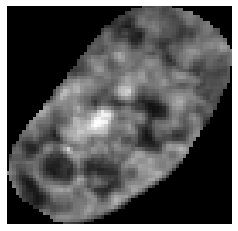

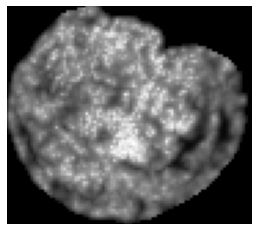

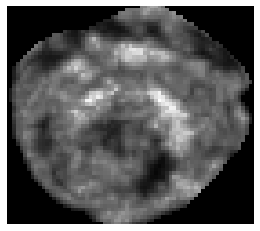

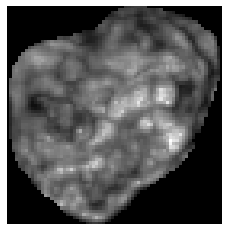

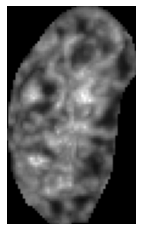

spectral.py (1966): nperseg = 256 is greater than input length  = 29, using nperseg = 29


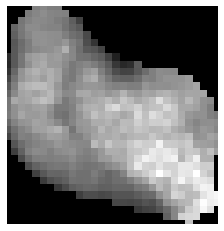

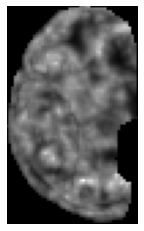

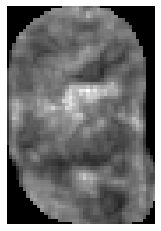

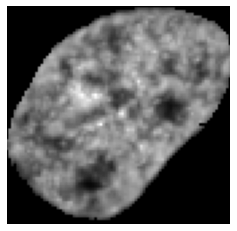

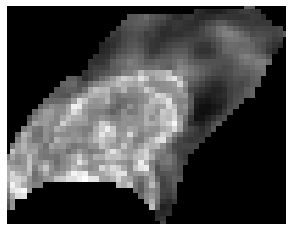

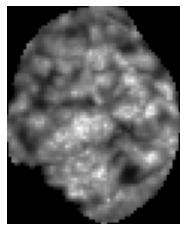

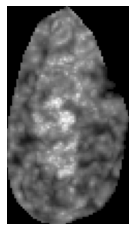

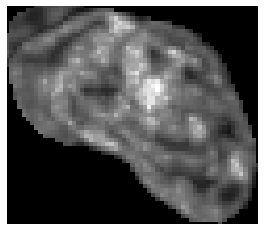

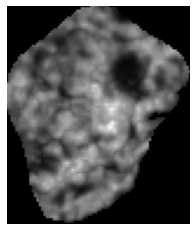

spectral.py (1966): nperseg = 256 is greater than input length  = 47, using nperseg = 47


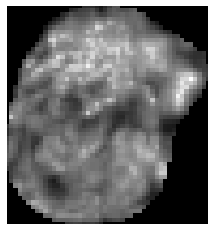

spectral.py (1966): nperseg = 256 is greater than input length  = 32, using nperseg = 32


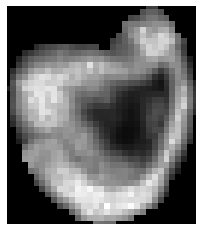

spectral.py (1966): nperseg = 256 is greater than input length  = 82, using nperseg = 82


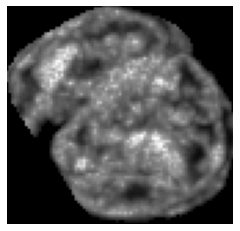

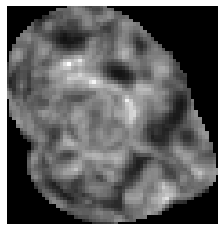

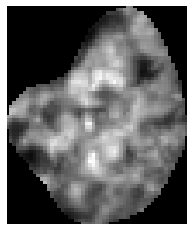

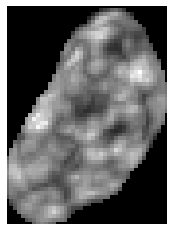

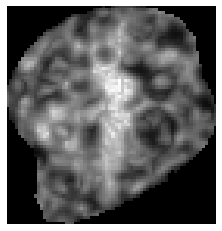

spectral.py (1966): nperseg = 256 is greater than input length  = 46, using nperseg = 46


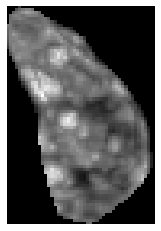

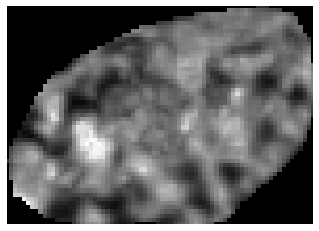

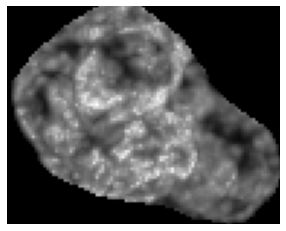

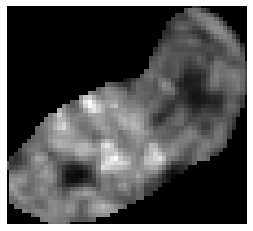

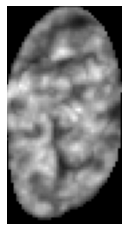

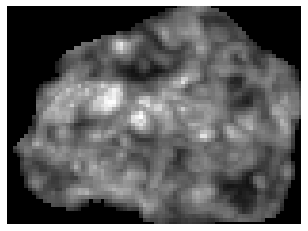

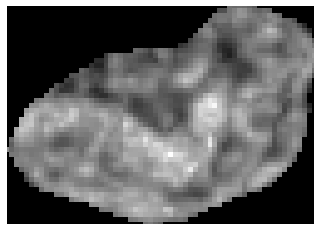

spectral.py (1966): nperseg = 256 is greater than input length  = 65, using nperseg = 65


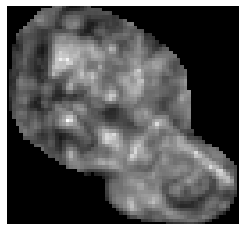

spectral.py (1966): nperseg = 256 is greater than input length  = 98, using nperseg = 98


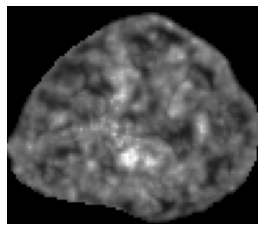

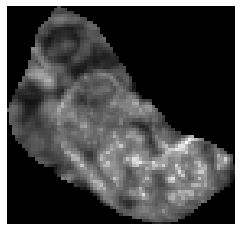

spectral.py (1966): nperseg = 256 is greater than input length  = 36, using nperseg = 36


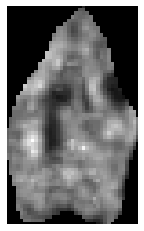

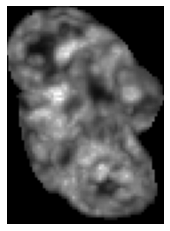

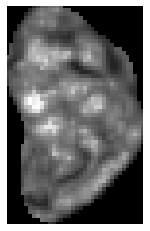

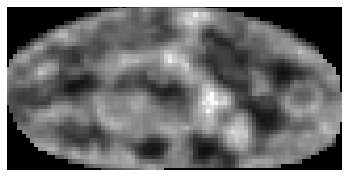

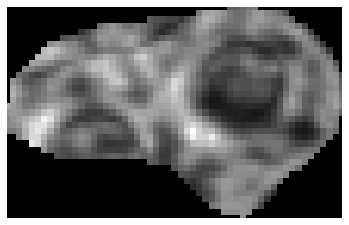

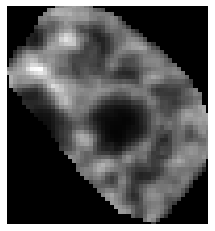

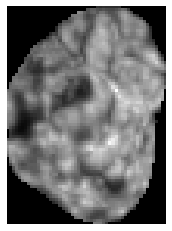

spectral.py (1966): nperseg = 256 is greater than input length  = 90, using nperseg = 90


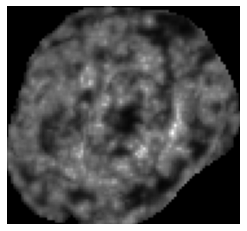

spectral.py (1966): nperseg = 256 is greater than input length  = 96, using nperseg = 96


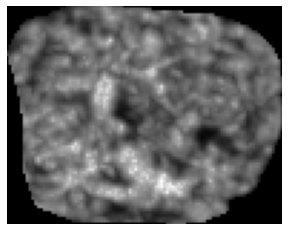

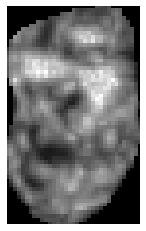

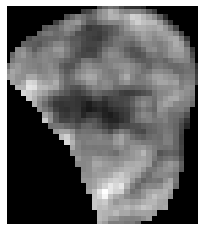

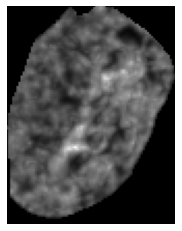

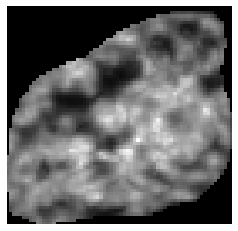

...

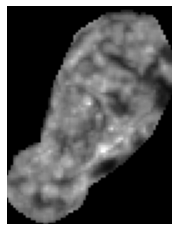

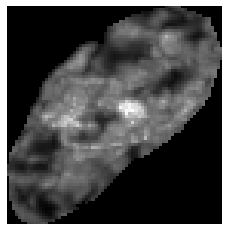

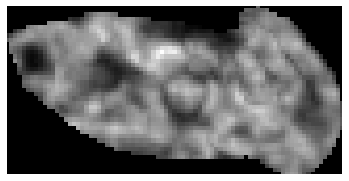

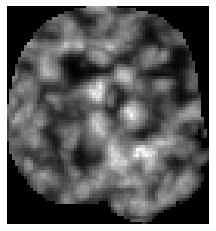

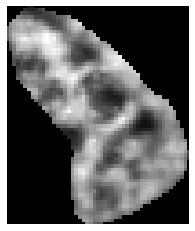

spectral.py (1966): nperseg = 256 is greater than input length  = 30, using nperseg = 30


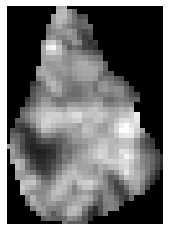

spectral.py (1966): nperseg = 256 is greater than input length  = 44, using nperseg = 44


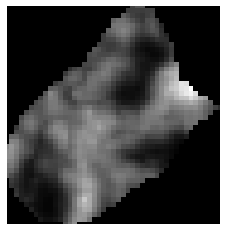

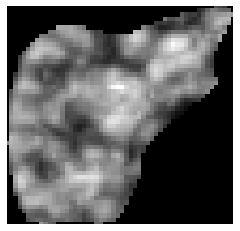

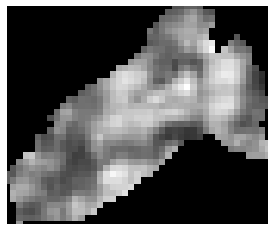

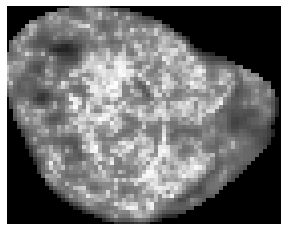

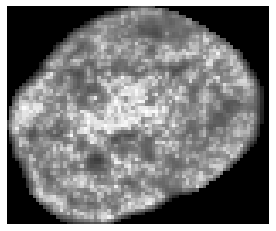

...

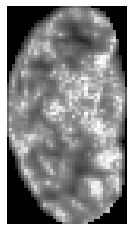

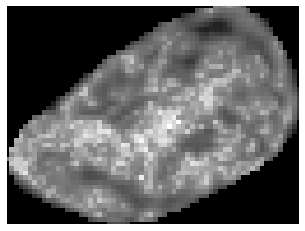

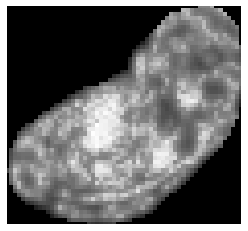

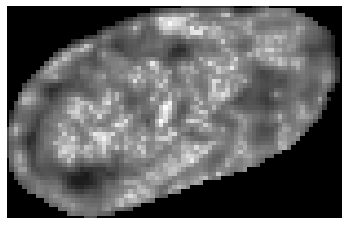

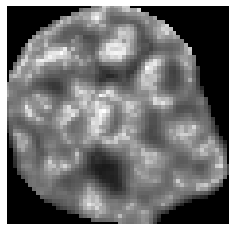

spectral.py (1966): nperseg = 256 is greater than input length  = 71, using nperseg = 71


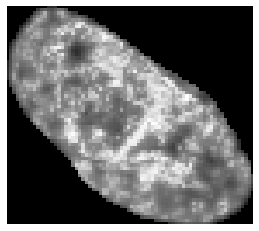

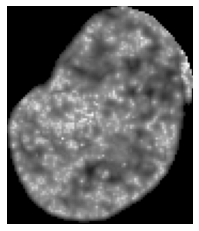

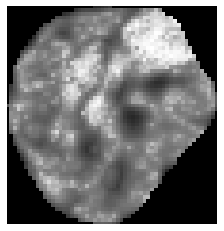

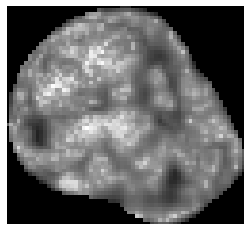

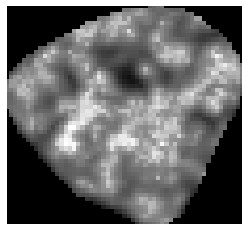

spectral.py (1966): nperseg = 256 is greater than input length  = 72, using nperseg = 72


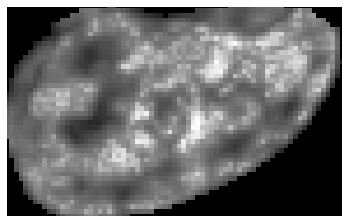

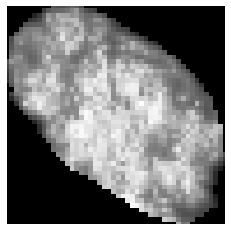

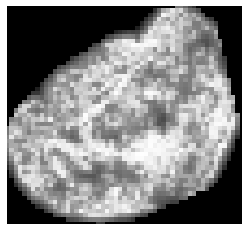

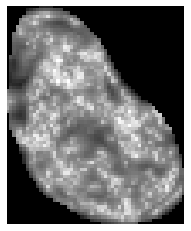

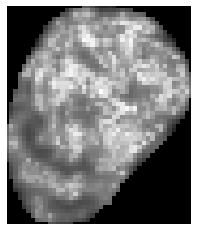

...

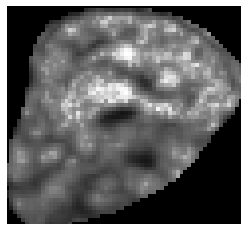

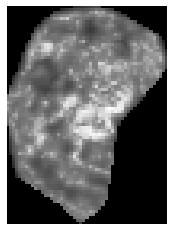

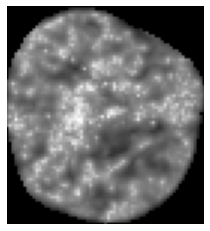

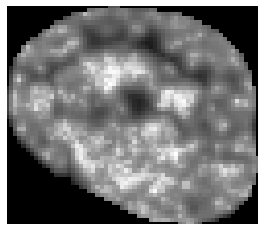

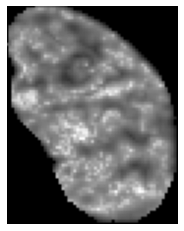

spectral.py (1966): nperseg = 256 is greater than input length  = 39, using nperseg = 39


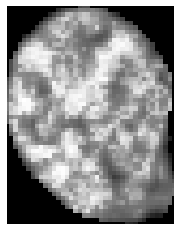

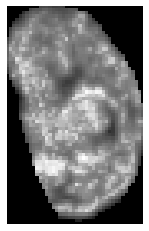

spectral.py (1966): nperseg = 256 is greater than input length  = 115, using nperseg = 115


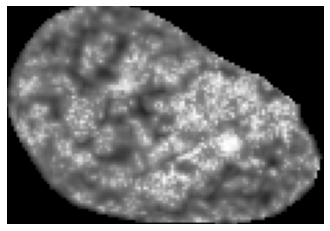

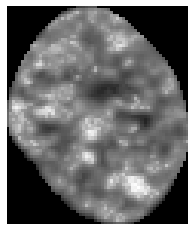

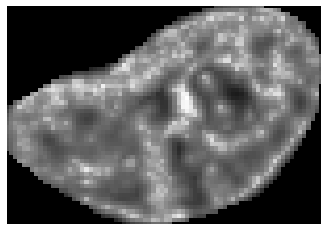

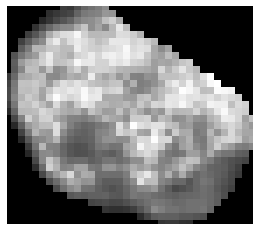

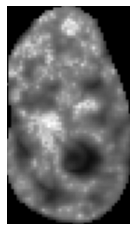

...

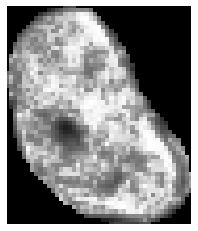

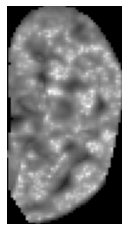

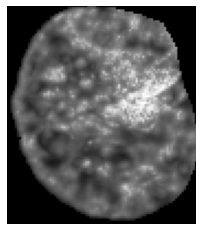

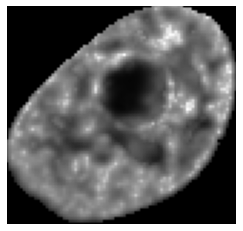

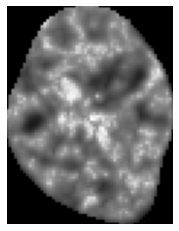

spectral.py (1966): nperseg = 256 is greater than input length  = 93, using nperseg = 93


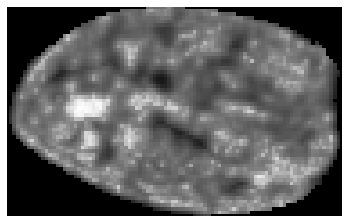

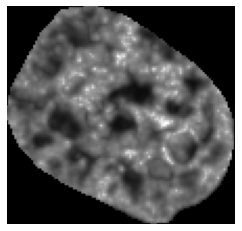

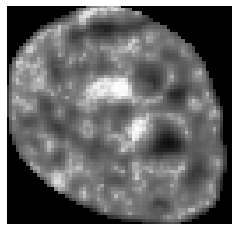

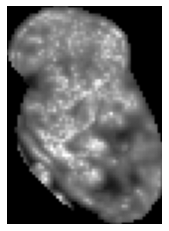

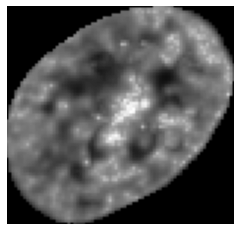

spectral.py (1966): nperseg = 256 is greater than input length  = 79, using nperseg = 79


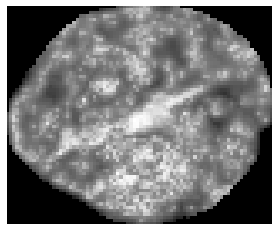

spectral.py (1966): nperseg = 256 is greater than input length  = 103, using nperseg = 103


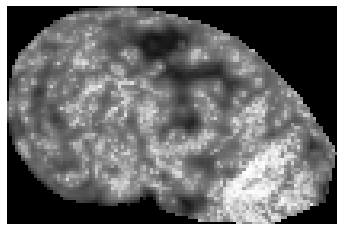

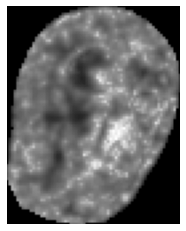

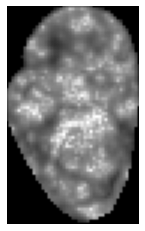

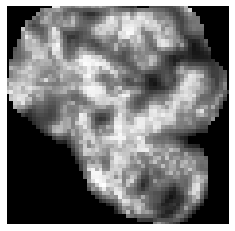

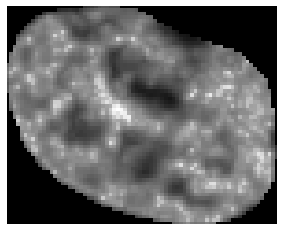

...

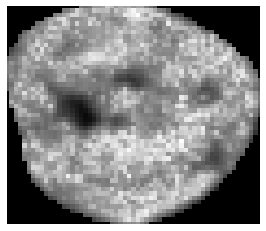

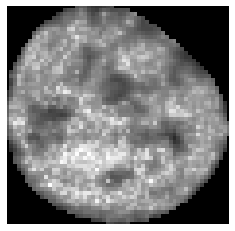

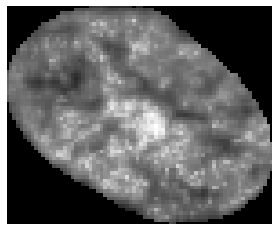

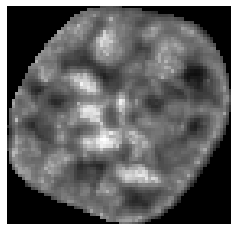

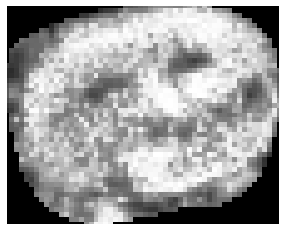

spectral.py (1966): nperseg = 256 is greater than input length  = 33, using nperseg = 33


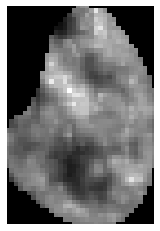

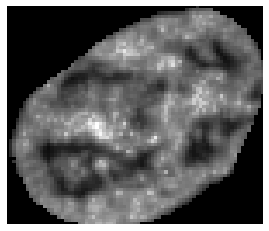

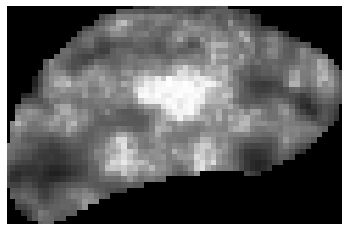

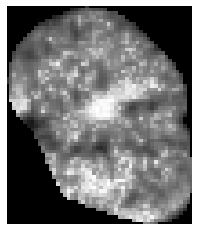

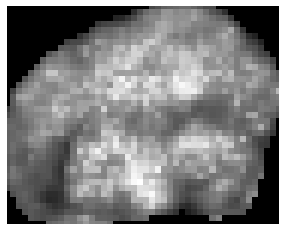

...

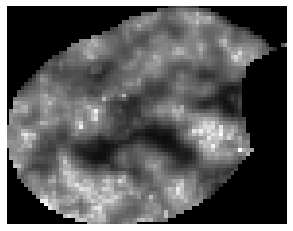

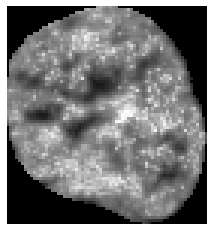

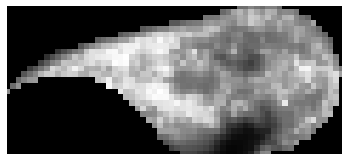

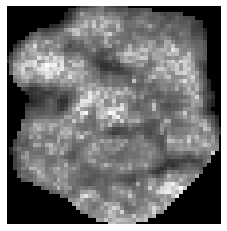

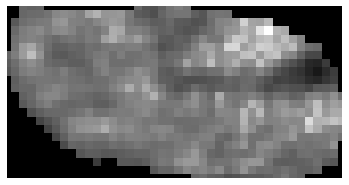

spectral.py (1966): nperseg = 256 is greater than input length  = 108, using nperseg = 108


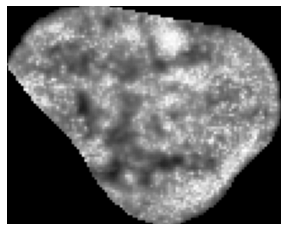

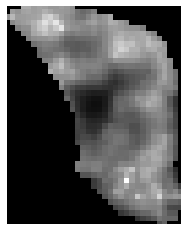

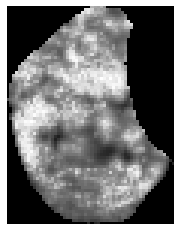

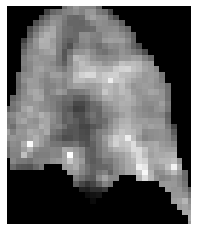

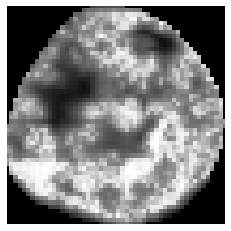

...

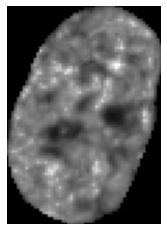

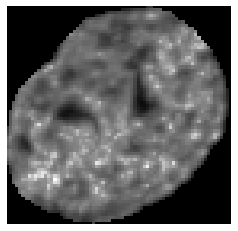

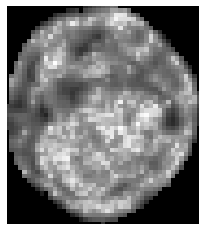

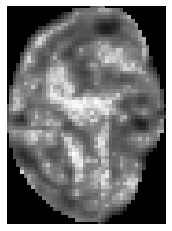

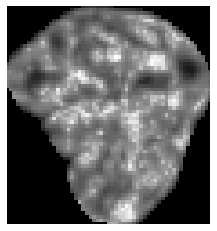

spectral.py (1966): nperseg = 256 is greater than input length  = 40, using nperseg = 40


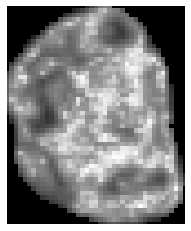

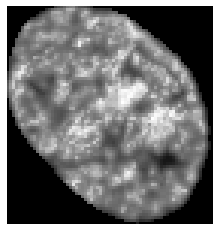

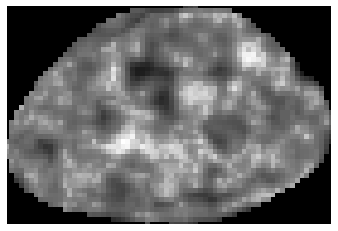

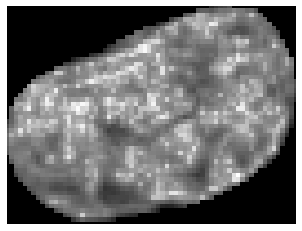

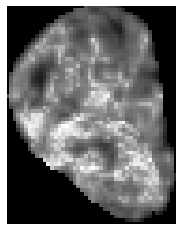

...

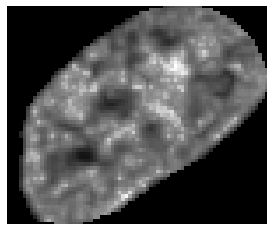

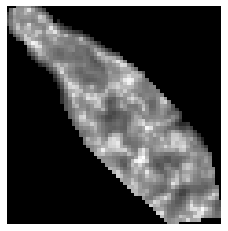

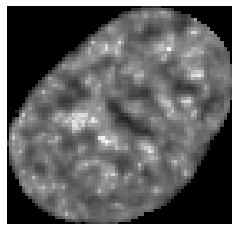

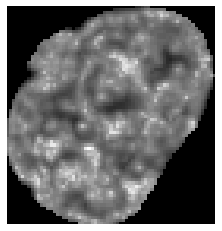

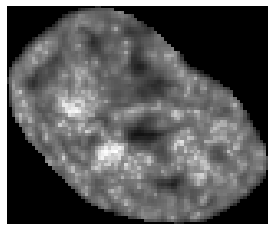

spectral.py (1966): nperseg = 256 is greater than input length  = 28, using nperseg = 28


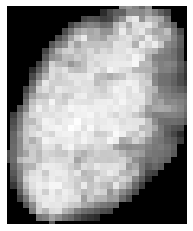

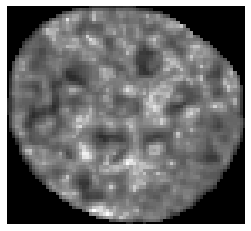

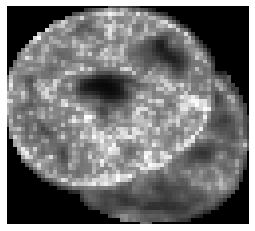

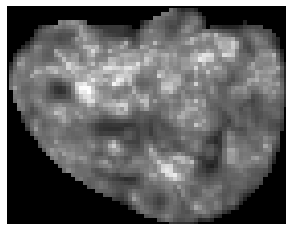

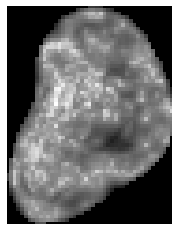

...

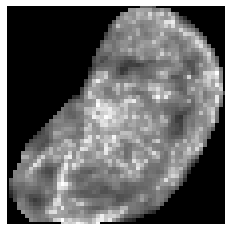

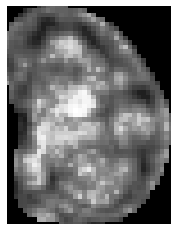

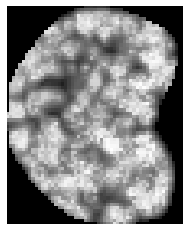

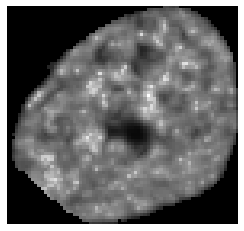

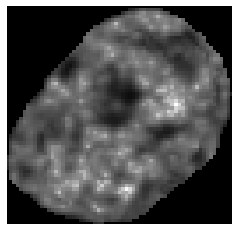

spectral.py (1966): nperseg = 256 is greater than input length  = 26, using nperseg = 26


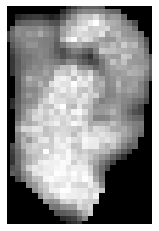

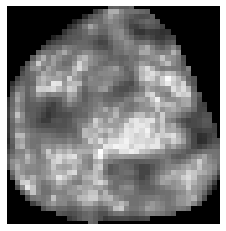

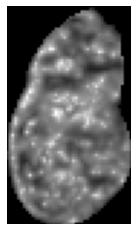

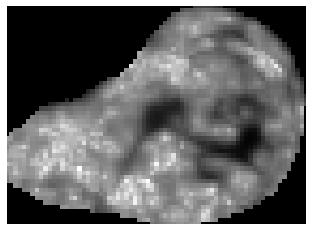

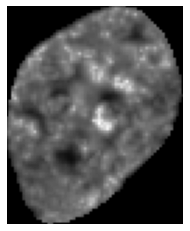

...

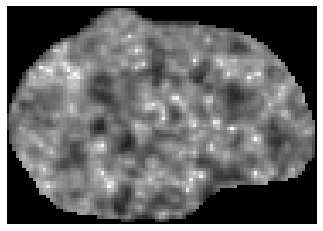

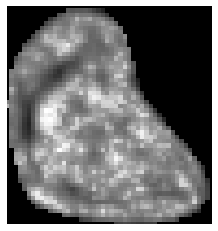

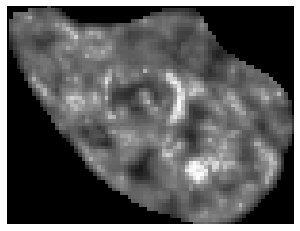

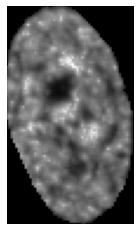

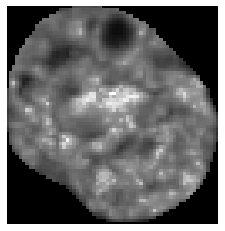

spectral.py (1966): nperseg = 256 is greater than input length  = 92, using nperseg = 92


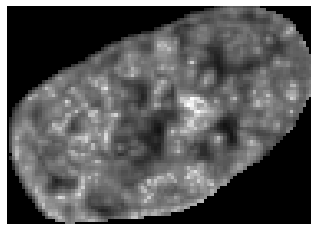

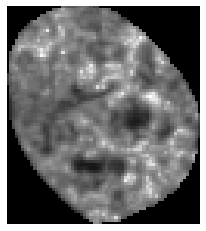

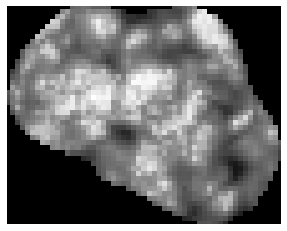

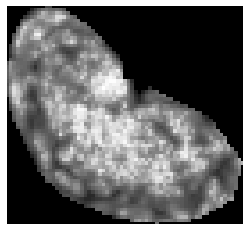

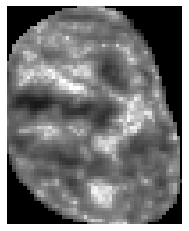

...

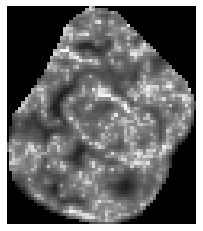

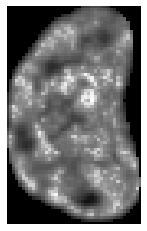

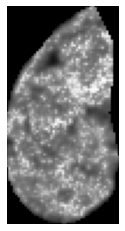

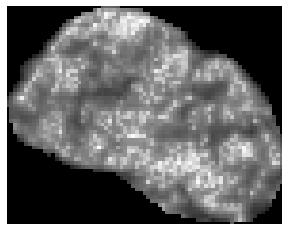

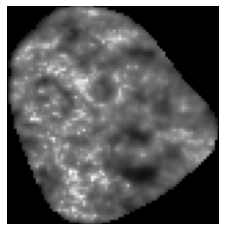

spectral.py (1966): nperseg = 256 is greater than input length  = 104, using nperseg = 104


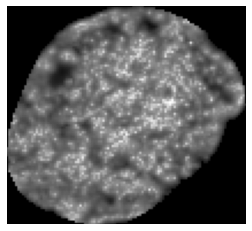

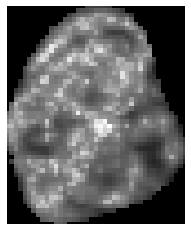

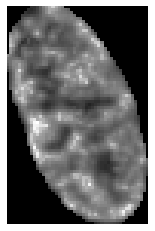

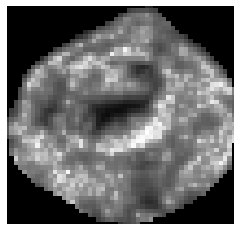

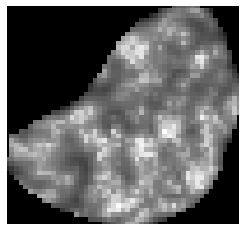

...

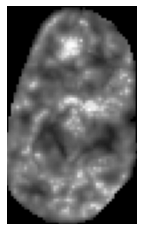

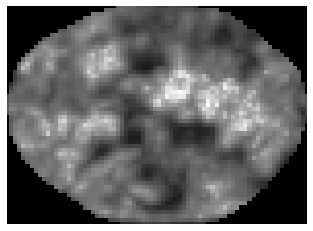

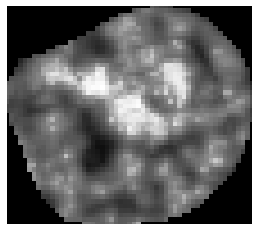

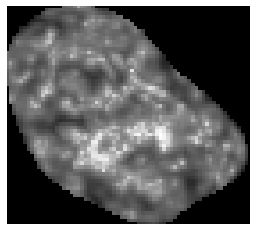

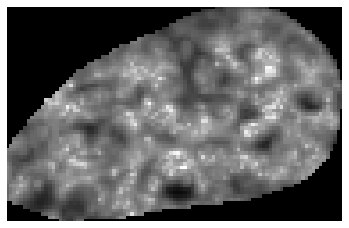

ImageFeatures.py (153): divide by zero encountered in log


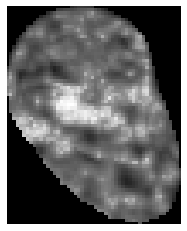

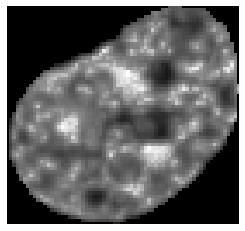

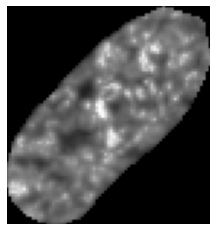

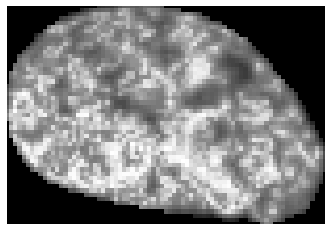

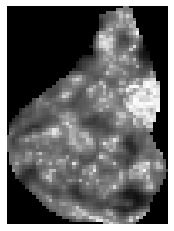

...

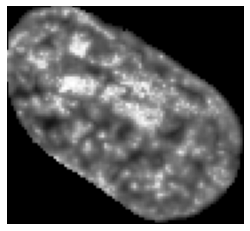

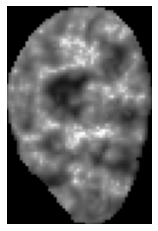

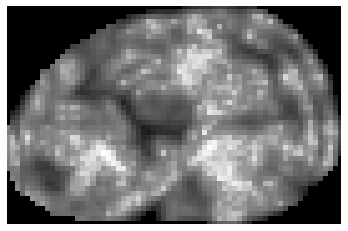

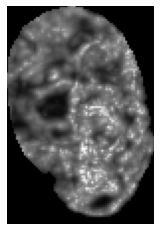

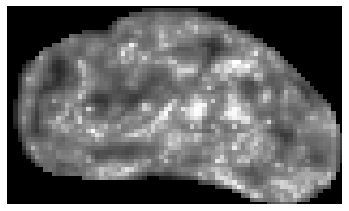

spectral.py (1966): nperseg = 256 is greater than input length  = 100, using nperseg = 100


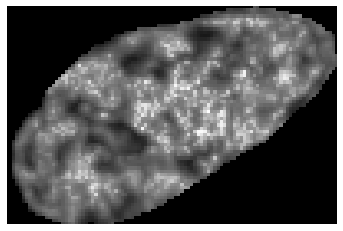

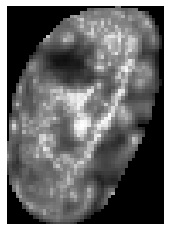

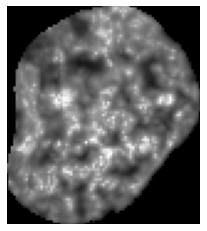

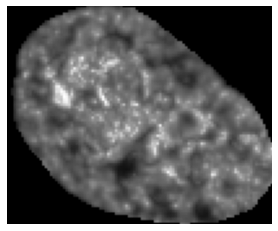

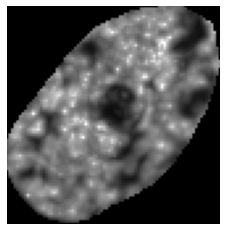

...

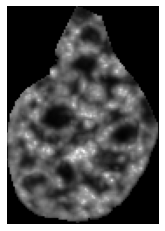

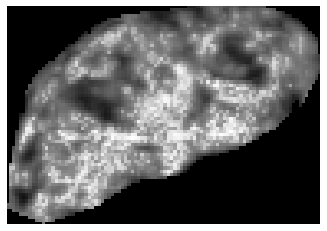

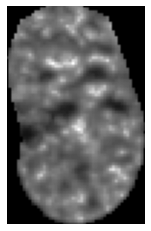

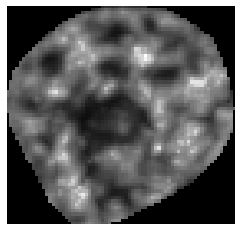

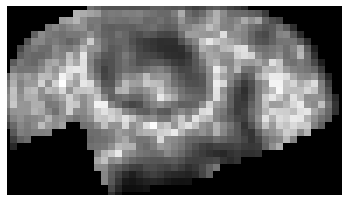

spectral.py (1966): nperseg = 256 is greater than input length  = 122, using nperseg = 122


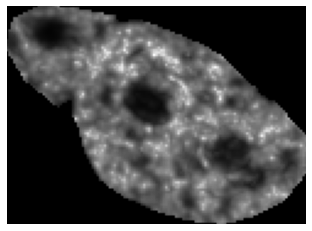

spectral.py (1966): nperseg = 256 is greater than input length  = 126, using nperseg = 126


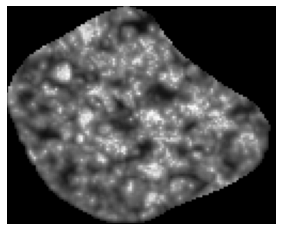

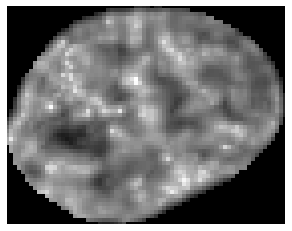

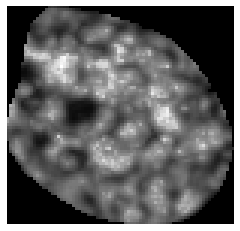

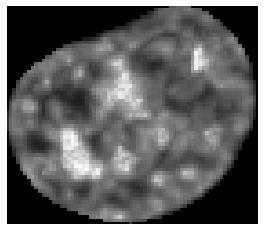

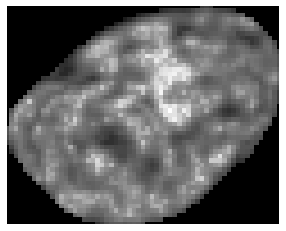

...

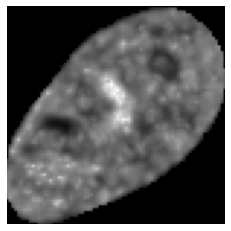

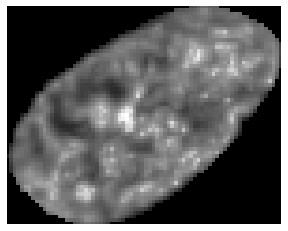

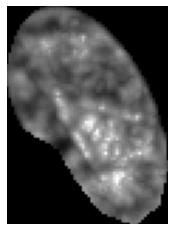

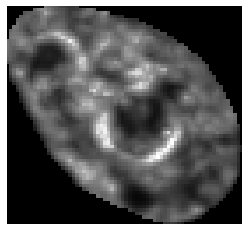

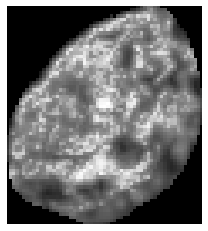

spectral.py (1966): nperseg = 256 is greater than input length  = 123, using nperseg = 123


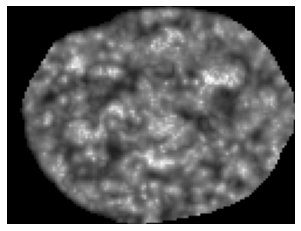

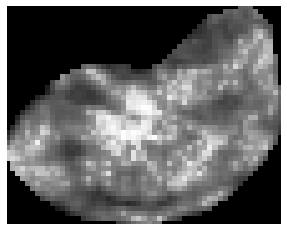

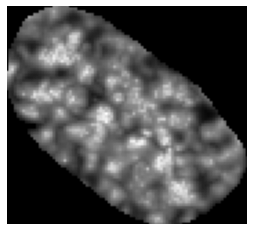

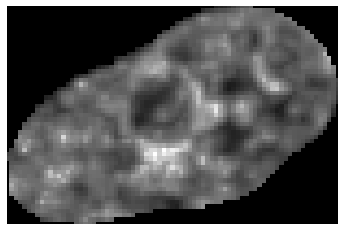

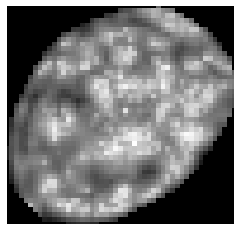

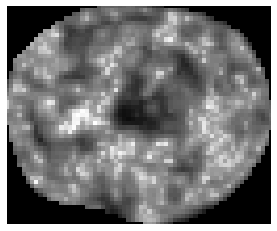

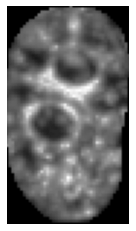

spectral.py (1966): nperseg = 256 is greater than input length  = 113, using nperseg = 113


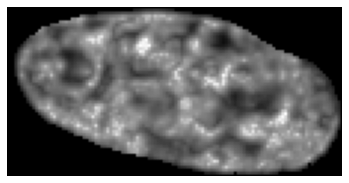

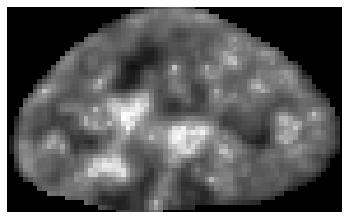

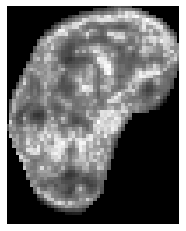

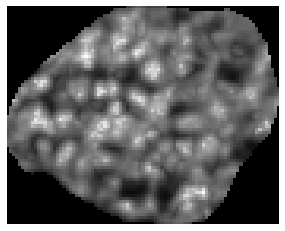

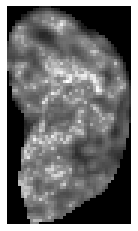

...

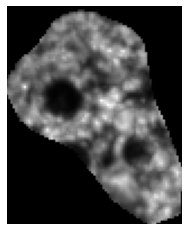

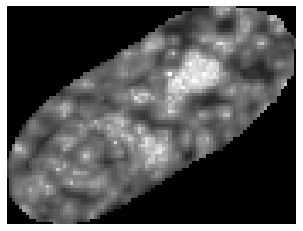

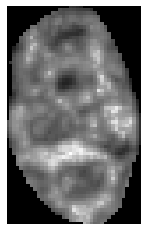

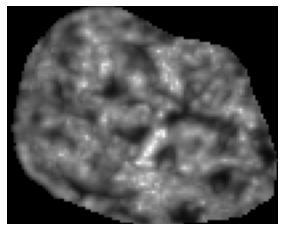

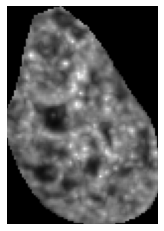

spectral.py (1966): nperseg = 256 is greater than input length  = 110, using nperseg = 110


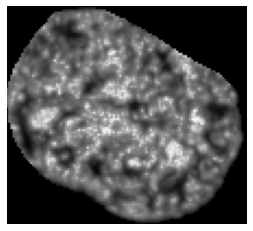

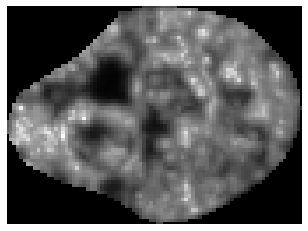

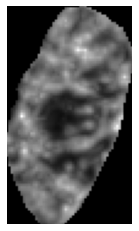

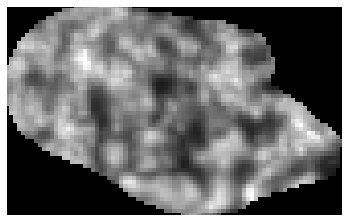

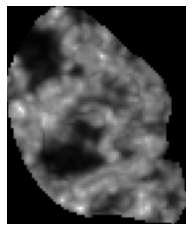

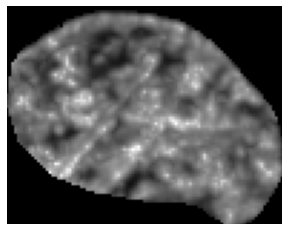

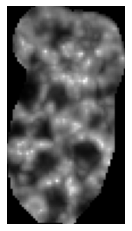

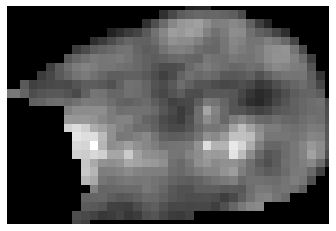

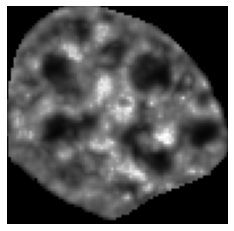

spectral.py (1966): nperseg = 256 is greater than input length  = 112, using nperseg = 112


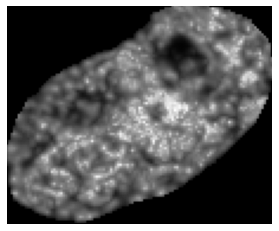

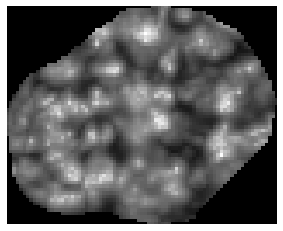

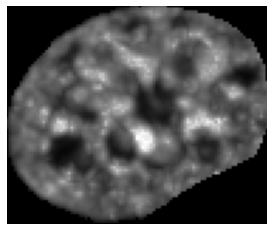

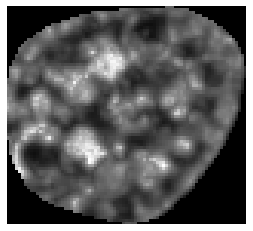

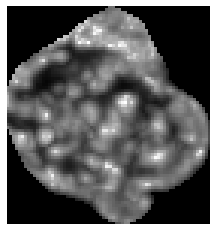

...

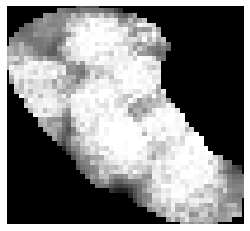

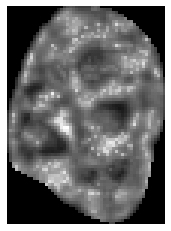

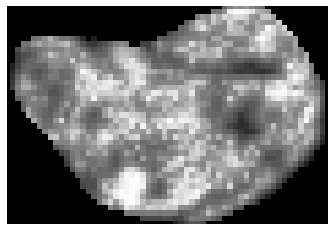

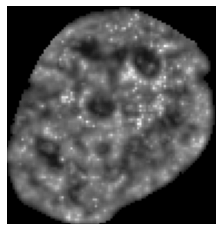

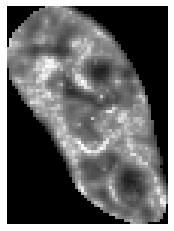

spectral.py (1966): nperseg = 256 is greater than input length  = 116, using nperseg = 116


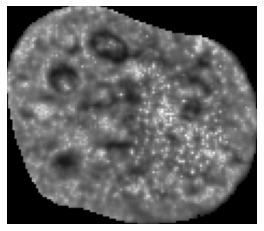

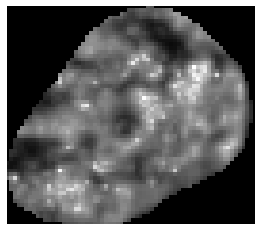

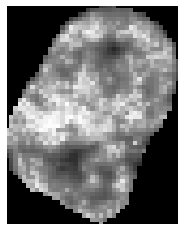

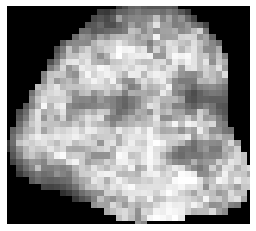

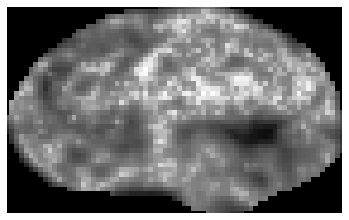

...

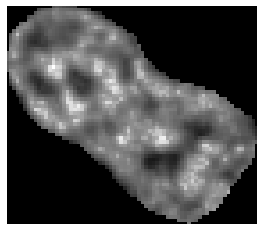

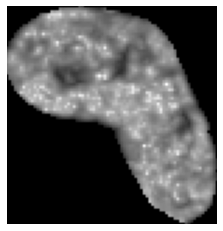

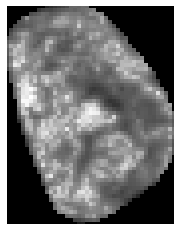

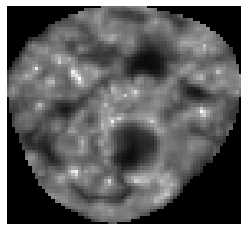

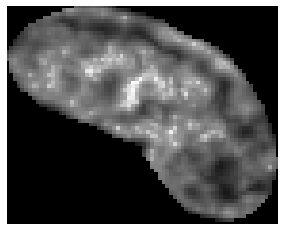

spectral.py (1966): nperseg = 256 is greater than input length  = 88, using nperseg = 88


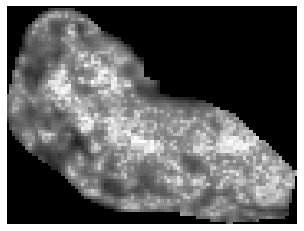

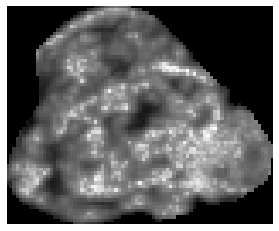

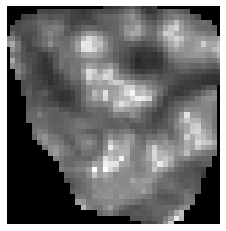

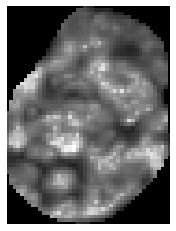

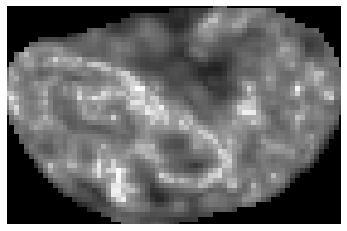

...

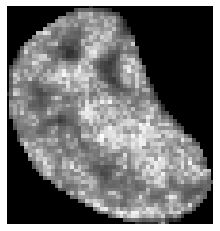

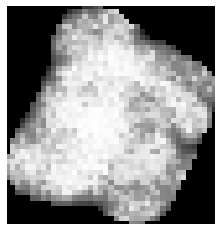

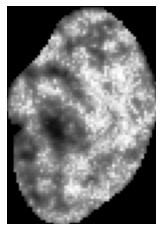

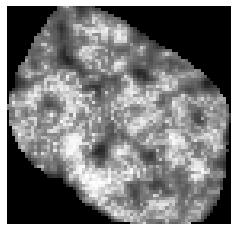

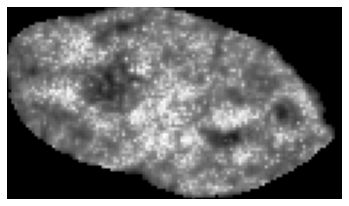

spectral.py (1966): nperseg = 256 is greater than input length  = 31, using nperseg = 31


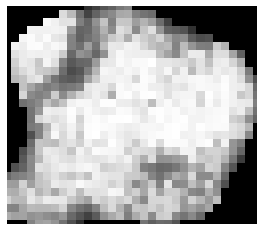

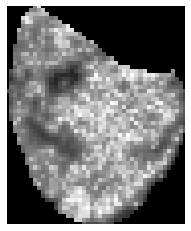

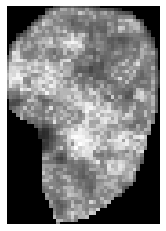

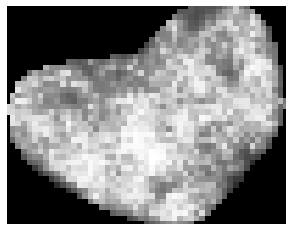

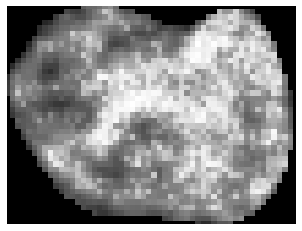

...

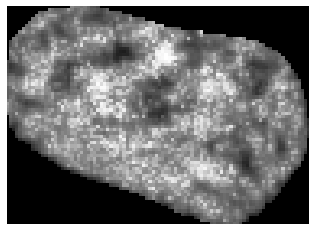

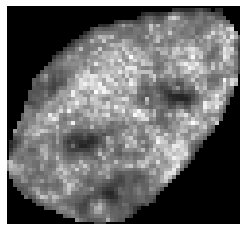

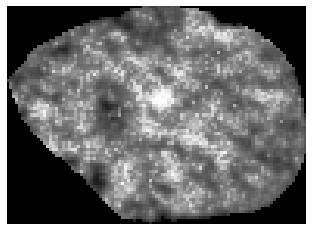

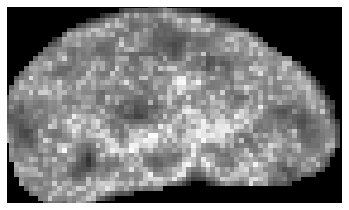

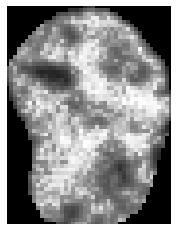

spectral.py (1966): nperseg = 256 is greater than input length  = 128, using nperseg = 128


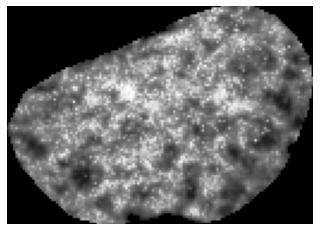

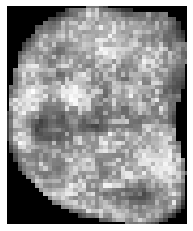

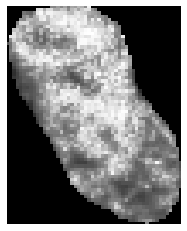

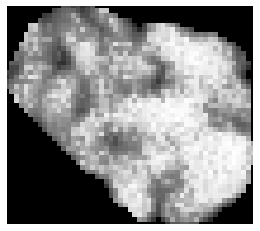

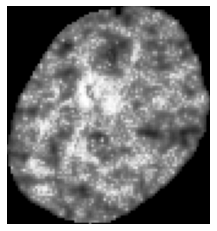

...

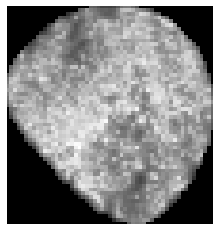

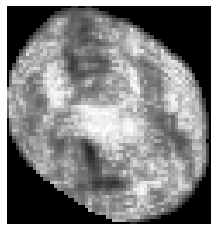

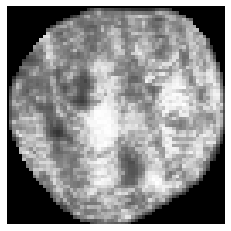

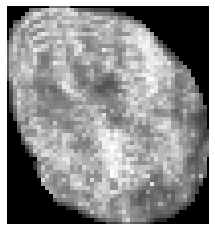

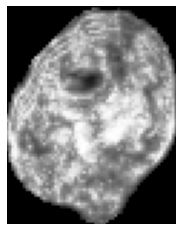

spectral.py (1966): nperseg = 256 is greater than input length  = 27, using nperseg = 27


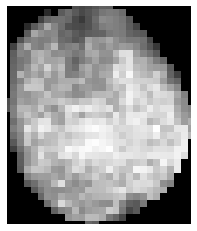

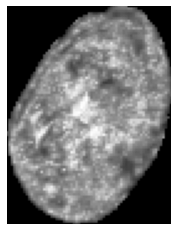

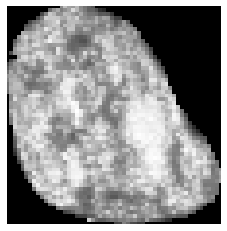

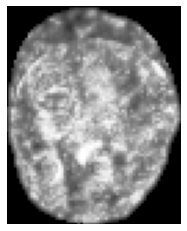

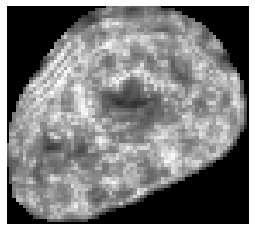

...

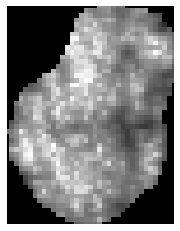

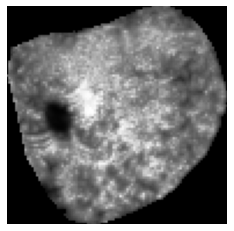

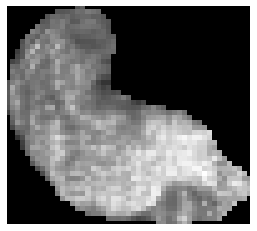

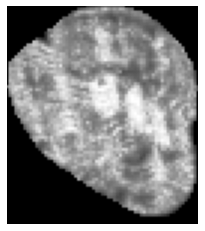

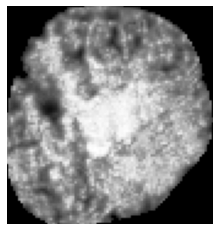

ImageFeatures.py (73): divide by zero encountered in double_scalars
ImageFeatures.py (78): invalid value encountered in double_scalars
spectral.py (1966): nperseg = 256 is greater than input length  = 2, using nperseg = 2


error, 70 , 63


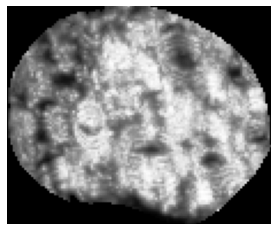

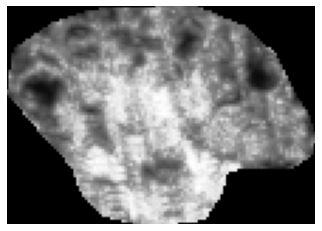

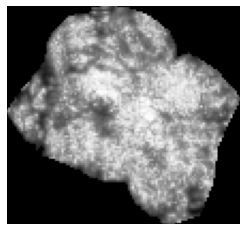

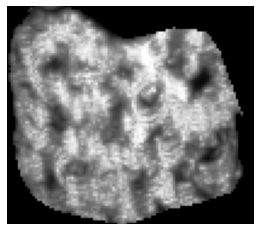

spectral.py (1966): nperseg = 256 is greater than input length  = 118, using nperseg = 118


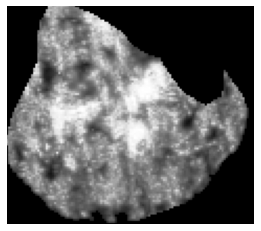

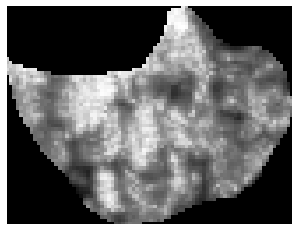

spectral.py (1966): nperseg = 256 is greater than input length  = 106, using nperseg = 106


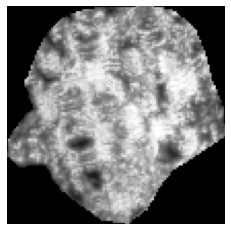

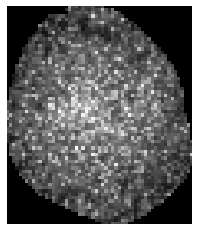

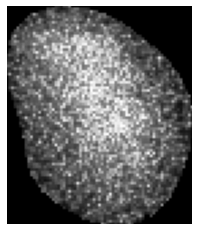

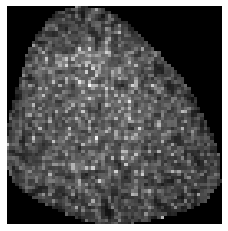

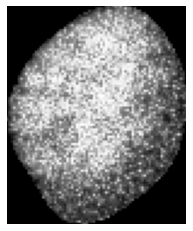

...

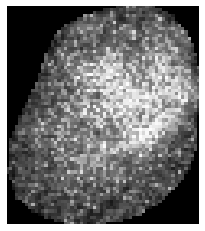

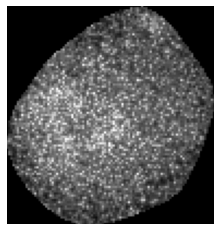

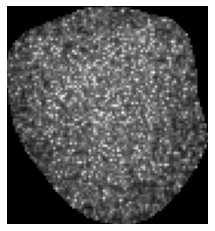

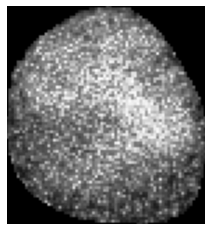

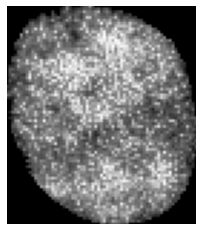

spectral.py (1966): nperseg = 256 is greater than input length  = 111, using nperseg = 111


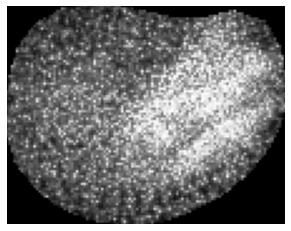

spectral.py (1966): nperseg = 256 is greater than input length  = 146, using nperseg = 146


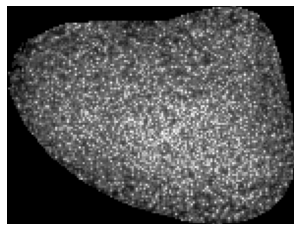

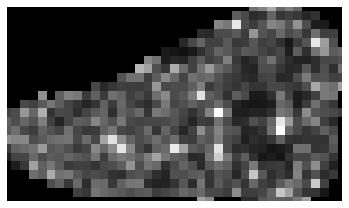

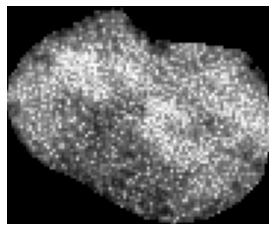

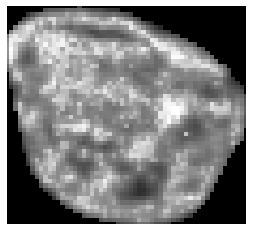

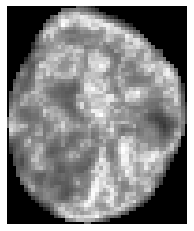

...

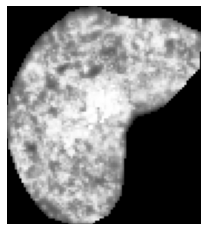

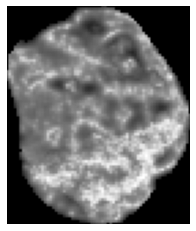

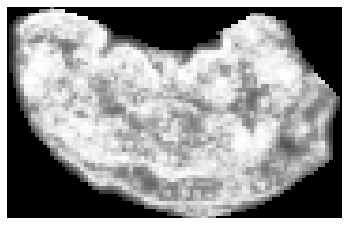

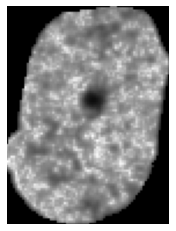

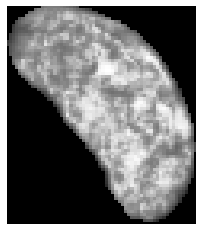

spectral.py (1966): nperseg = 256 is greater than input length  = 135, using nperseg = 135


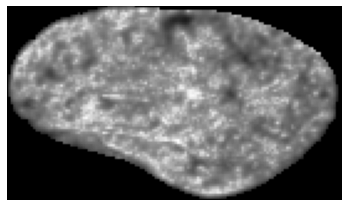

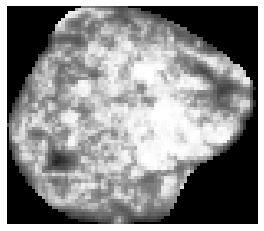

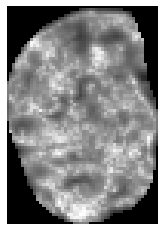

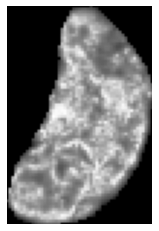

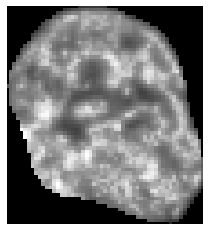

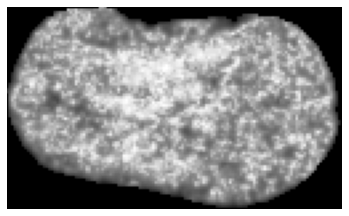

spectral.py (1966): nperseg = 256 is greater than input length  = 120, using nperseg = 120


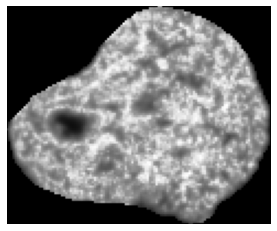

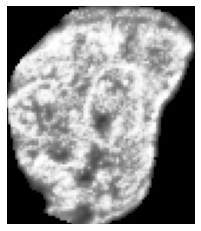

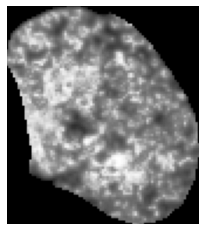

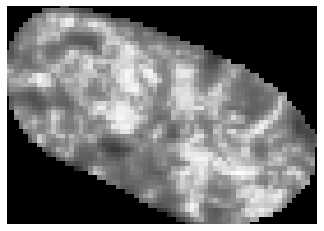

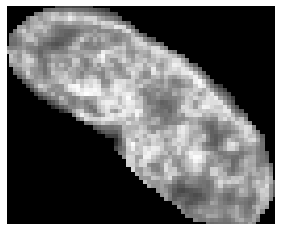

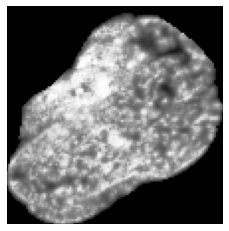

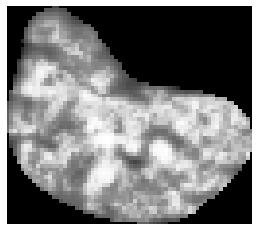

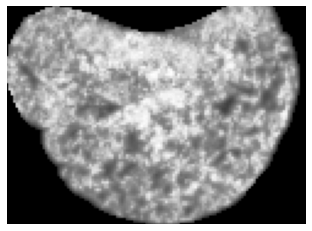

spectral.py (1966): nperseg = 256 is greater than input length  = 114, using nperseg = 114


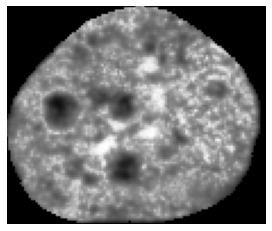

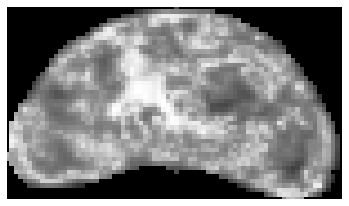

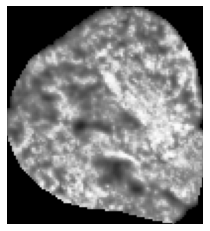

In [8]:
NucleiResultsDF = analyze_nuclei(Centroids,NucleiDeconvDF,True)

In [7]:
NucleiResultsDF

,Name,Img Index,Label,Mask,Patches,Fractal Dimension,DNF:Area,DNF:BB Area,DNF:Perimeter,DNF:Area convex,...,DNF:Invariant Contrast,DNF:Invariant Homogeneity,DNF:Invariant Energy,DNF:Mean Gabor Power,DNF:Gabor Variance,DNF:Gabor Mean,DNF:Gabor Energy,DNF:Gabor Entropy,DNF:Mean Spectral Magnitude,DNF:Mean Spectral Power
0,MAX_11_6IF_CHO_L_w3z_decon_ch00_PS.tif,11,WT,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...",1.136092,2789,3700,205.338,2851,...,1135.984,0.248,0.215,0.050,13268.806,77.803,10.384,3.363,138.156,0.050
1,MAX_11_6IF_CHO_L_w3z_decon_ch00_PS.tif,11,WT,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...",0.899687,3570,4692,225.723,3627,...,931.542,0.249,0.213,0.055,13190.722,77.785,10.181,3.317,136.954,0.047
2,MAX_11_6IF_CHO_L_w3z_decon_ch00_PS.tif,11,WT,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...",1.619750,1736,2205,152.953,1767,...,1355.247,0.216,0.175,0.044,12590.331,71.799,11.205,3.334,133.115,0.045
3,MAX_11_6IF_CHO_L_w3z_decon_ch00_PS.tif,11,WT,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...",0.850084,3735,5025,232.208,3794,...,702.224,0.268,0.232,0.051,12870.991,73.523,7.645,3.099,135.366,0.050
4,MAX_11_6IF_CHO_L_w3z_decon_ch00_PS.tif,11,WT,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...",0.987025,2968,3685,204.853,3016,...,873.559,0.205,0.166,0.057,13473.536,79.859,8.769,3.295,136.026,0.059
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1526,MAX_9_6IF_CHO_L_w3z_decon_ch00_PS.tif,9,WT,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...",1.342511,2254,3528,194.995,2451,...,996.503,0.364,0.331,0.041,12352.902,70.863,10.044,3.189,135.448,0.043
1527,MAX_9_6IF_CHO_L_w3z_decon_ch00_PS.tif,9,WT,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...",1.324620,8214,10680,368.392,8705,...,746.361,0.263,0.224,0.041,12625.148,71.388,7.242,3.077,143.544,0.033
1528,MAX_9_6IF_CHO_L_w3z_decon_ch00_PS.tif,9,WT,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...",0.985331,8279,10640,343.948,8374,...,588.195,0.273,0.223,0.041,11602.653,62.892,5.723,2.764,141.307,0.035
1529,MAX_9_6IF_CHO_L_w3z_decon_ch00_PS.tif,9,WT,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...","[[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...",1.050340,2345,3225,207.338,2565,...,1163.429,0.273,0.236,0.053,13148.562,78.594,11.564,3.362,135.415,0.035


In [9]:
NucleiResultsDF.to_excel(os.getcwd() + '\\NucleiResults.xlsx') 

In [23]:
NucleiResultsDF = pd.read_excel(os.getcwd() + '\\NucleiResults.xlsx',index_col=0)

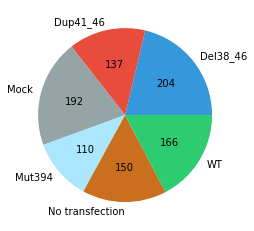

In [4]:
colors  = ['#3498DB','#E74C3C','#95A5A6','#ABE6FF','#CA6F1E','#2ECC71']
labels  = list(np.unique(ResultsDF['Label']))
try:
    labels.remove('Synthetic')
except:
    pass

def absolute_value(val):
    a  = int(np.round(val/100.*np.array([204, 137, 192, 110,150,166]).sum(), 0))
    return a


plt.pie(np.array([204, 137, 192, 110,150,166]),labels = labels,autopct=absolute_value,colors=colors)
plt.show()

## <font color='red'>6.3.4 Barplots</font>

In [44]:
import statannot
def plot_barplot_nuclei(df,save):

    data = copy.deepcopy(df)
    
    #cols     = [x for x in FULL.columns if x.startswith("LSF2D") or x.startswith("LSF1D") or x.startswith("DCF") or x.startswith("DNF") or x.startswith("SKNW") or x.startswith("OTHERS")]
    cols = [x for x in df.columns if x.startswith("DNF")]
    #feats_1D = [x for x in df.columns if x.startswith("LSF2D")]
    #feats    = [x for x in df.columns if x.startswith("LSF1D") or x.startswith("DCF") or x.startswith("DNF") or x.startswith("SKNW") or x.startswith("OTHERS")]
    colors   = ["#2ECC71","#FFA500","#E74C3C","#E74C3C"]
    labels   = ['WT','Dup41_46','Del38_46','Mut394']
    pairs    = [(('WT', 'Dup41_46')), (('WT', 'Del38_46')), (('WT', 'Mut394'))]  
    
    for f in cols:
        fig,ax = plt.subplots()
        sns.barplot(x="Label", y=f, data=data,order=['WT','Dup41_46','Del38_46','Mut394'],palette=colors,capsize=.1)
        statannot.add_stat_annotation(plt.gca(),data=data,x="Label",y=f,order=['WT','Dup41_46','Del38_46','Mut394'],box_pairs=pairs,test='t-test_ind',text_format="star",loc="outside",fontsize='small',comparisons_correction=None)
        ax.set_ylabel(f[4:])
        if save:
            plt.savefig(".//NucleiSofia//" + str(f.split(':')[0]) + "-"  + str(f.split(':')[1]) + ".png",format='png',transparent=True,bbox_inches='tight',dpi=200)
            
        
        plt.show()
        
print('FUNCTION: plot_barplot_nuclei')

FUNCTION: plot_barplot_nuclei


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.446e-01 stat=-9.462e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.597e-05 stat=4.350e+00
WT v.s. Mut394: t-test independent samples, P_val=5.103e-02 stat=-1.957e+00


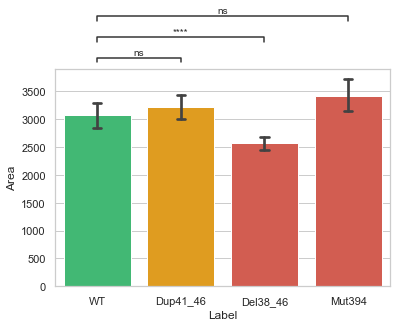

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.848e-01 stat=-8.701e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.563e-06 stat=4.547e+00
WT v.s. Mut394: t-test independent samples, P_val=5.790e-02 stat=-1.902e+00


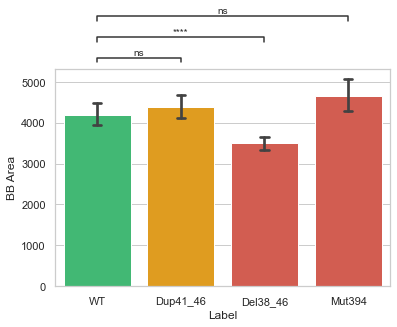

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.732e-01 stat=-1.097e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.224e-05 stat=4.409e+00
WT v.s. Mut394: t-test independent samples, P_val=5.017e-02 stat=-1.965e+00


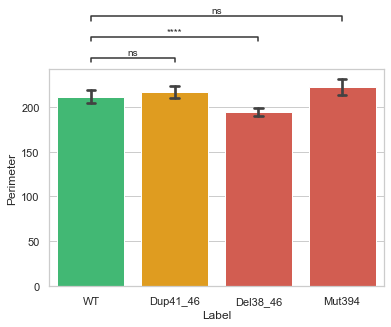

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.429e-01 stat=-9.496e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.526e-05 stat=4.360e+00
WT v.s. Mut394: t-test independent samples, P_val=5.202e-02 stat=-1.949e+00


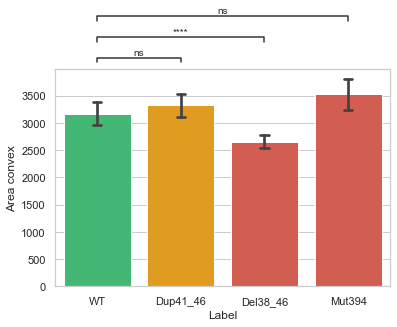

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.881e-01 stat=-1.318e+00
WT v.s. Del38_46: t-test independent samples, P_val=9.693e-01 stat=3.854e-02
WT v.s. Mut394: t-test independent samples, P_val=1.243e-03 stat=-3.252e+00


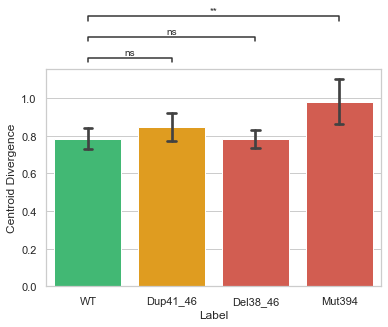

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.229e-01 stat=-1.221e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.038e-05 stat=4.294e+00
WT v.s. Mut394: t-test independent samples, P_val=4.461e-02 stat=-2.015e+00


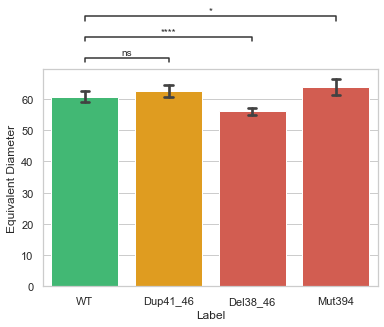

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.517e-01 stat=-7.533e-01
WT v.s. Del38_46: t-test independent samples, P_val=4.297e-01 stat=-7.902e-01
WT v.s. Mut394: t-test independent samples, P_val=5.055e-01 stat=-6.665e-01


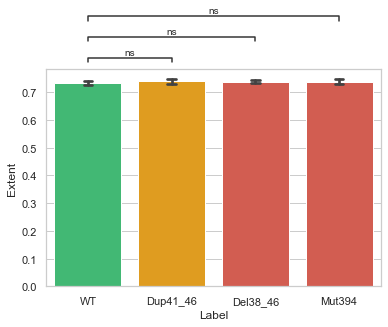

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.535e-01 stat=-4.492e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.176e-05 stat=4.418e+00
WT v.s. Mut394: t-test independent samples, P_val=1.469e-01 stat=-1.453e+00


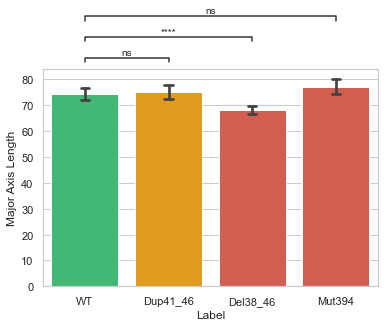

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.616e-02 stat=-1.778e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.802e-04 stat=3.573e+00
WT v.s. Mut394: t-test independent samples, P_val=2.548e-02 stat=-2.243e+00


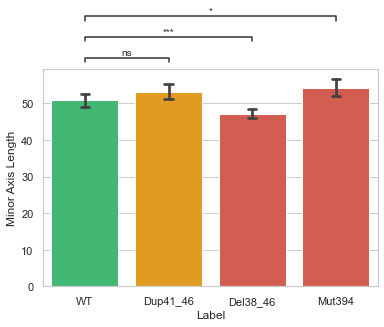

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.804e-02 stat=2.081e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.835e-01 stat=8.722e-01
WT v.s. Mut394: t-test independent samples, P_val=3.874e-01 stat=8.653e-01


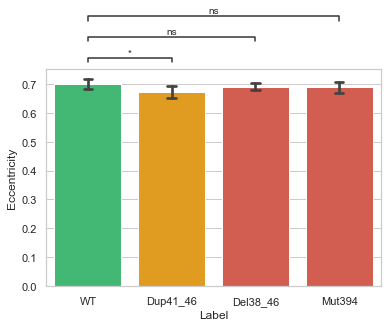

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.299e-01 stat=-9.754e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.232e-01 stat=-4.916e-01
WT v.s. Mut394: t-test independent samples, P_val=7.993e-01 stat=-2.545e-01


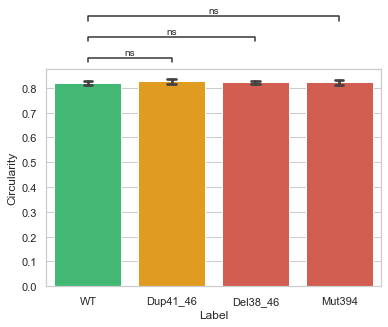

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.138e-02 stat=-2.160e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.521e-01 stat=-7.523e-01
WT v.s. Mut394: t-test independent samples, P_val=2.877e-01 stat=-1.065e+00


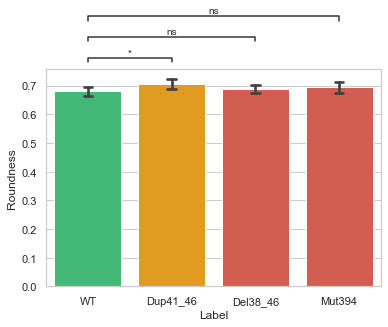

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.696e-02 stat=-1.716e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.231e-01 stat=-9.889e-01
WT v.s. Mut394: t-test independent samples, P_val=3.682e-01 stat=-9.008e-01


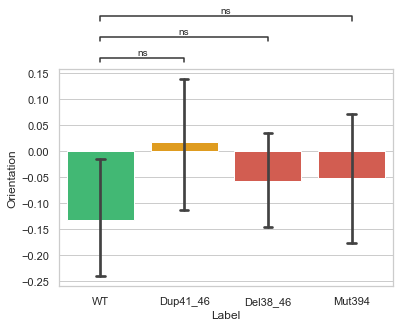

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.200e-01 stat=-2.276e-01
WT v.s. Del38_46: t-test independent samples, P_val=4.277e-01 stat=7.937e-01
WT v.s. Mut394: t-test independent samples, P_val=7.282e-01 stat=-3.478e-01


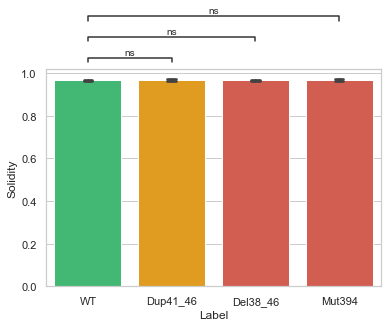

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.129e-01 stat=-8.196e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.767e-01 stat=-4.172e-01
WT v.s. Mut394: t-test independent samples, P_val=1.668e-01 stat=-1.385e+00


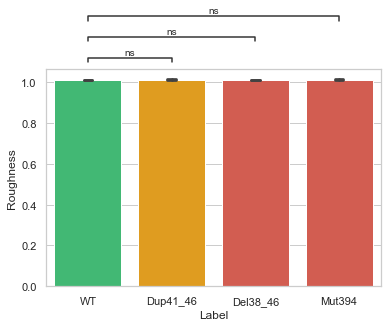

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.683e-02 stat=2.094e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.444e-01 stat=3.262e-01
WT v.s. Mut394: t-test independent samples, P_val=2.567e-01 stat=1.136e+00


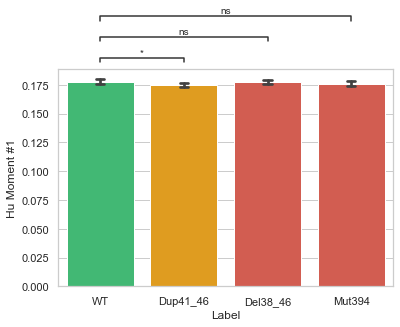

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.747e-02 stat=2.213e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.924e-01 stat=2.634e-01
WT v.s. Mut394: t-test independent samples, P_val=2.972e-01 stat=1.044e+00


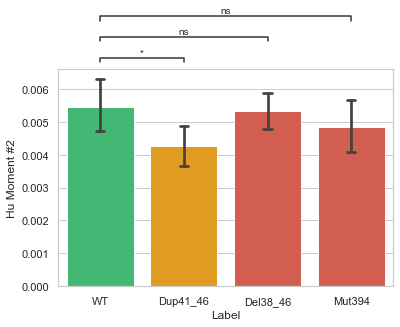

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.745e-01 stat=5.618e-01
WT v.s. Del38_46: t-test independent samples, P_val=3.782e-01 stat=8.818e-01
WT v.s. Mut394: t-test independent samples, P_val=1.670e-01 stat=1.384e+00


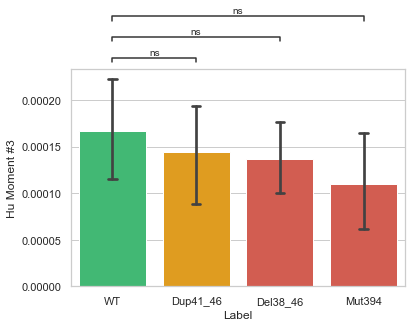

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.846e-08 stat=5.603e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.018e-02 stat=-2.578e+00
WT v.s. Mut394: t-test independent samples, P_val=4.854e-03 stat=2.833e+00


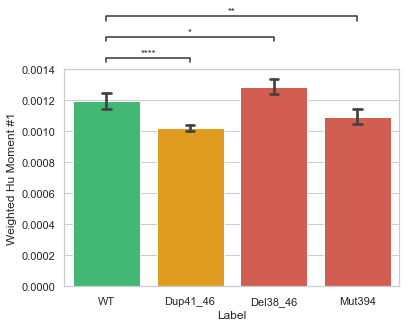

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan


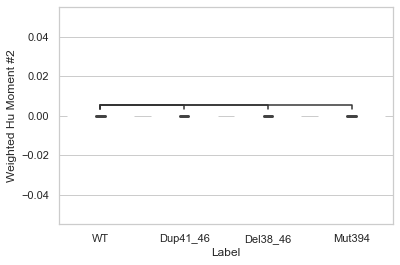

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan


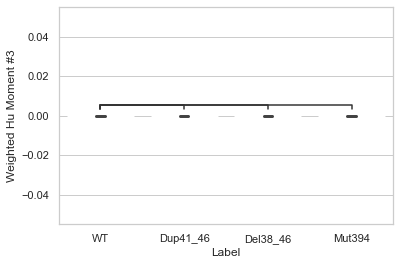

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.673e-01 stat=-5.725e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.915e-06 stat=4.536e+00
WT v.s. Mut394: t-test independent samples, P_val=1.052e-01 stat=-1.624e+00


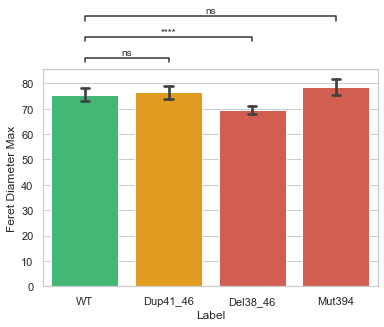

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.717e-01 stat=-1.101e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.303e-05 stat=4.396e+00
WT v.s. Mut394: t-test independent samples, P_val=4.812e-02 stat=-1.982e+00


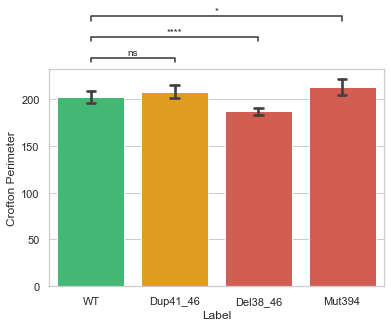

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.634e-14 stat=-7.708e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.299e-21 stat=9.757e+00
WT v.s. Mut394: t-test independent samples, P_val=4.198e-02 stat=-2.040e+00


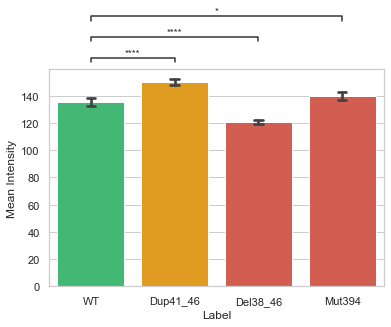

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.775e-19 stat=-9.497e+00
WT v.s. Del38_46: t-test independent samples, P_val=9.892e-01 stat=1.358e-02
WT v.s. Mut394: t-test independent samples, P_val=1.724e-02 stat=-2.392e+00


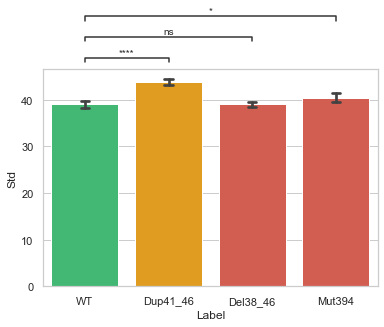

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.570e-17 stat=-8.748e+00
WT v.s. Del38_46: t-test independent samples, P_val=8.329e-01 stat=2.111e-01
WT v.s. Mut394: t-test independent samples, P_val=1.803e-02 stat=-2.375e+00


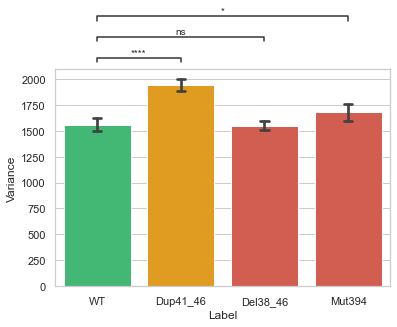

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.374e-06 stat=4.786e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.384e-11 stat=-6.752e+00
WT v.s. Mut394: t-test independent samples, P_val=4.419e-01 stat=7.697e-01


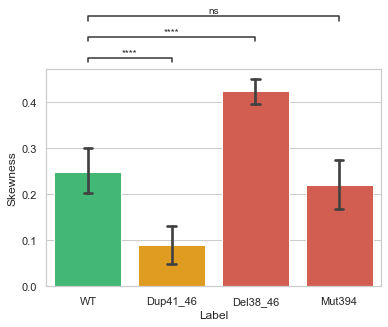

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.354e-26 stat=1.133e+01
WT v.s. Del38_46: t-test independent samples, P_val=6.579e-05 stat=-4.019e+00
WT v.s. Mut394: t-test independent samples, P_val=4.319e-03 stat=2.870e+00


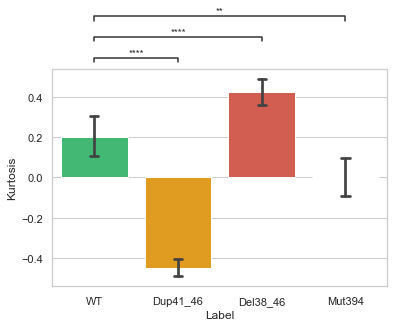

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan


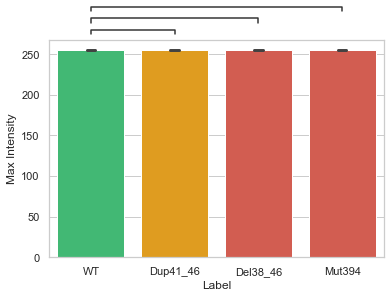

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.432e-03 stat=-3.051e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.755e-17 stat=8.713e+00
WT v.s. Mut394: t-test independent samples, P_val=3.552e-01 stat=-9.256e-01


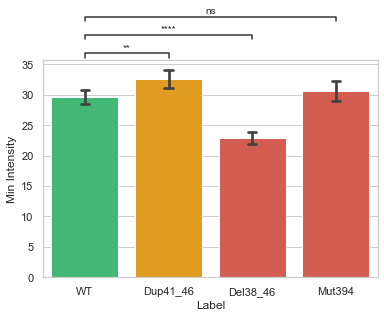

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.733e-05 stat=-4.112e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.196e-01 stat=-3.592e-01
WT v.s. Mut394: t-test independent samples, P_val=1.049e-01 stat=-1.625e+00


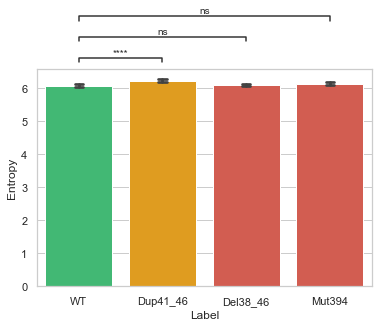

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.258e-01 stat=-3.510e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.535e-06 stat=4.548e+00
WT v.s. Mut394: t-test independent samples, P_val=1.835e-01 stat=-1.332e+00


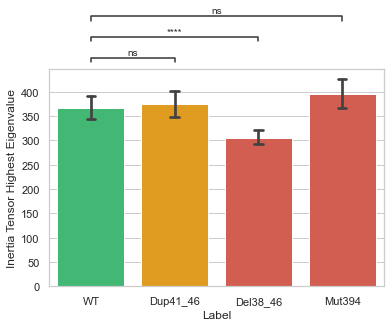

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.875e-01 stat=-1.320e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.592e-04 stat=3.589e+00
WT v.s. Mut394: t-test independent samples, P_val=2.614e-02 stat=-2.233e+00


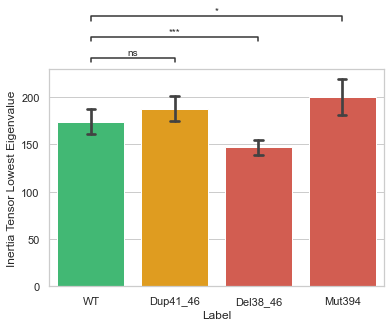

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.725e-01 stat=4.230e-01
WT v.s. Del38_46: t-test independent samples, P_val=4.180e-01 stat=8.105e-01
WT v.s. Mut394: t-test independent samples, P_val=6.778e-01 stat=4.157e-01


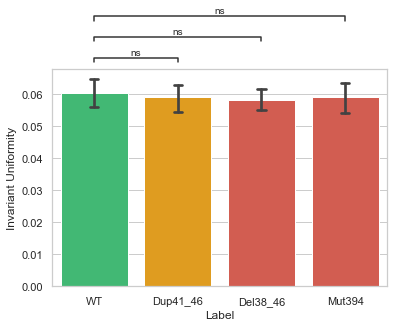

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.033e-03 stat=-3.105e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.004e-06 stat=4.941e+00
WT v.s. Mut394: t-test independent samples, P_val=5.785e-03 stat=-2.775e+00


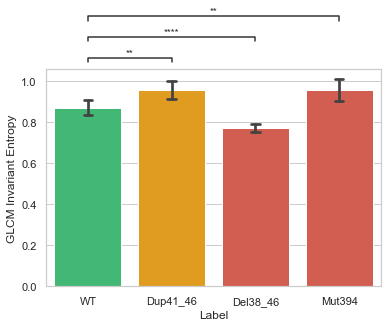

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.494e-04 stat=3.606e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.319e-06 stat=4.886e+00
WT v.s. Mut394: t-test independent samples, P_val=7.826e-04 stat=3.385e+00


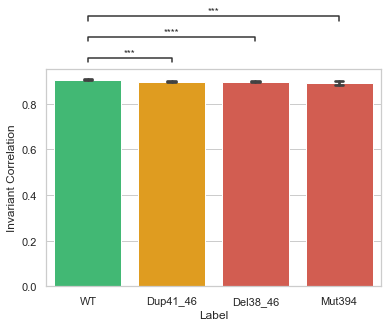

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.576e-28 stat=-1.184e+01
WT v.s. Del38_46: t-test independent samples, P_val=8.549e-03 stat=2.638e+00
WT v.s. Mut394: t-test independent samples, P_val=3.988e-05 stat=-4.155e+00


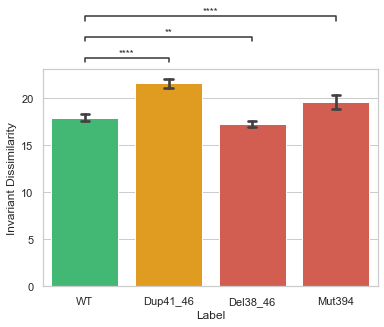

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.176e-22 stat=-1.033e+01
WT v.s. Del38_46: t-test independent samples, P_val=1.108e-02 stat=2.548e+00
WT v.s. Mut394: t-test independent samples, P_val=8.701e-06 stat=-4.506e+00


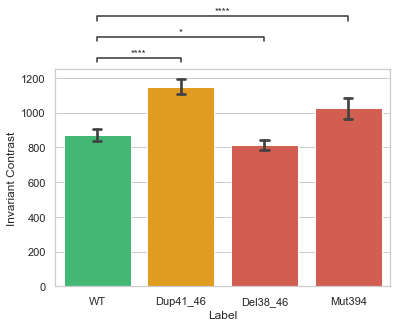

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.693e-02 stat=1.773e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.240e-01 stat=4.905e-01
WT v.s. Mut394: t-test independent samples, P_val=4.228e-01 stat=8.024e-01


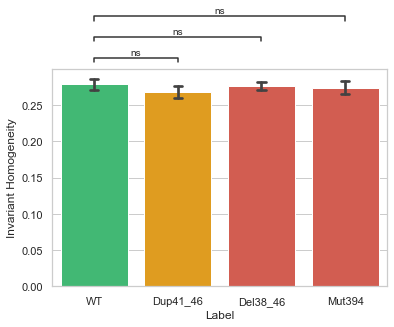

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.701e-01 stat=4.263e-01
WT v.s. Del38_46: t-test independent samples, P_val=3.366e-01 stat=9.616e-01
WT v.s. Mut394: t-test independent samples, P_val=6.973e-01 stat=3.892e-01


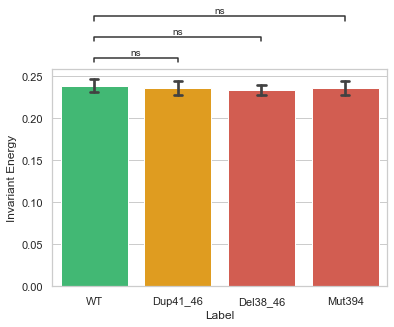

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.225e-01 stat=8.029e-01
WT v.s. Del38_46: t-test independent samples, P_val=5.383e-08 stat=-5.507e+00
WT v.s. Mut394: t-test independent samples, P_val=1.247e-01 stat=1.539e+00


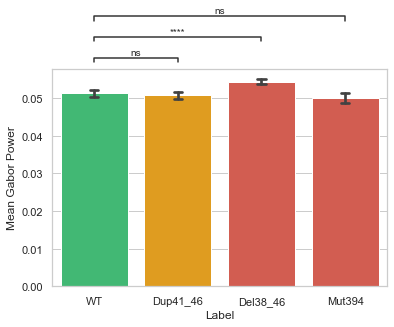

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.565e-20 stat=-9.802e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.475e-01 stat=1.450e+00
WT v.s. Mut394: t-test independent samples, P_val=1.594e-01 stat=-1.410e+00


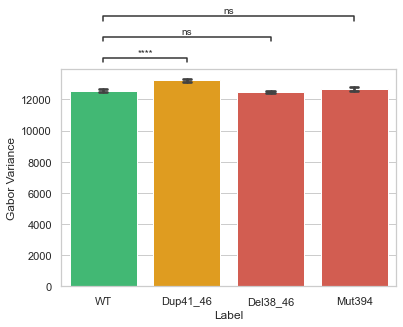

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.769e-16 stat=-8.532e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.881e-01 stat=6.938e-01
WT v.s. Mut394: t-test independent samples, P_val=3.898e-01 stat=-8.610e-01


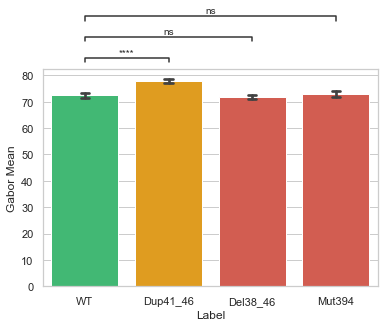

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.757e-08 stat=-5.471e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.323e-01 stat=1.196e+00
WT v.s. Mut394: t-test independent samples, P_val=6.450e-01 stat=-4.611e-01


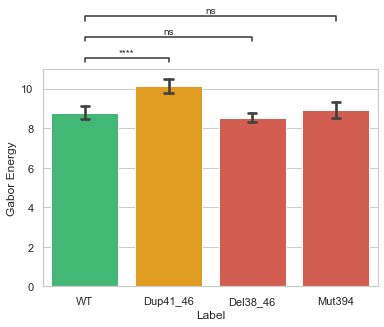

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.356e-17 stat=-8.936e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.638e-02 stat=2.226e+00
WT v.s. Mut394: t-test independent samples, P_val=2.803e-01 stat=-1.081e+00


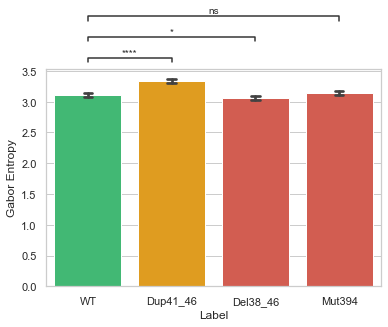

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.300e-38 stat=-1.436e+01
WT v.s. Del38_46: t-test independent samples, P_val=2.456e-10 stat=6.437e+00
WT v.s. Mut394: t-test independent samples, P_val=8.821e-10 stat=-6.282e+00


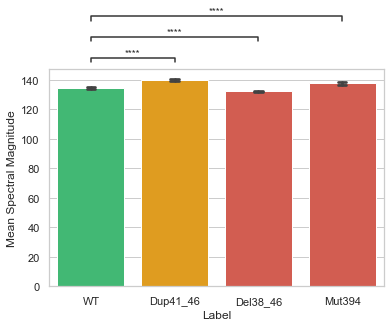

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.962e-11 stat=-6.835e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.006e-06 stat=-4.566e+00
WT v.s. Mut394: t-test independent samples, P_val=7.957e-07 stat=-5.017e+00


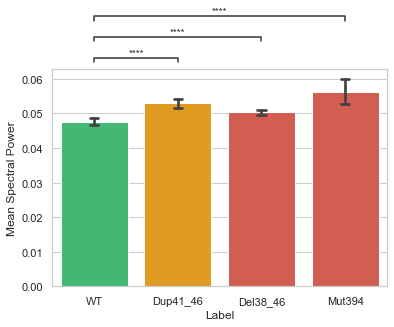

In [45]:
plot_barplot_nuclei(df=NucleiResultsDF,save=True)

## <font color='red'>6.3.4 Violinplots</font>

In [46]:
import statannot
def plot_violinplot_nuclei(df,save):
    data   = copy.deepcopy(df)
    cols   = [x for x in df.columns if x.startswith("DNF")]
    colors = ["#2ECC71","#FFA500","#E74C3C","#E74C3C"]
    labels = ['WT','Dup41_46','Del38_46','Mut394']
    pairs  = [(('WT', 'Dup41_46')), (('WT', 'Del38_46')), (('WT', 'Mut394'))]  
    
    for f in cols:
        sns.set_theme(style="whitegrid")
        sns.violinplot(x="Label", y=f, data=data,order=['WT','Dup41_46','Del38_46','Mut394'],palette=colors,inner="quartiles",scale_hue=True)
        statannot.add_stat_annotation(plt.gca(),data=data,x="Label",y=f,order=['WT','Dup41_46','Del38_46','Mut394'],box_pairs=pairs,test='t-test_ind',text_format="star",loc="outside",fontsize='small',comparisons_correction=None)
        sns.despine(left=True)
        if save:
            plt.savefig(".//NucleiSofia//" + str(f.split(':')[0]) + "-"  + str(f.split(':')[1]) + ".png",format='png',transparent=True,bbox_inches='tight',dpi=200)
            
        
        plt.show()
        
print('FUNCTION: plot_violinplot_nuclei')

FUNCTION: plot_violinplot_nuclei


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.446e-01 stat=-9.462e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.597e-05 stat=4.350e+00
WT v.s. Mut394: t-test independent samples, P_val=5.103e-02 stat=-1.957e+00


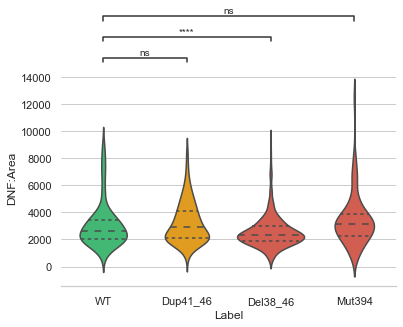

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.848e-01 stat=-8.701e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.563e-06 stat=4.547e+00
WT v.s. Mut394: t-test independent samples, P_val=5.790e-02 stat=-1.902e+00


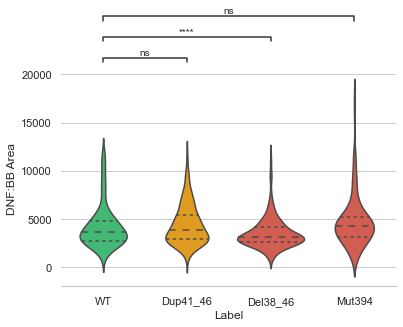

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.732e-01 stat=-1.097e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.224e-05 stat=4.409e+00
WT v.s. Mut394: t-test independent samples, P_val=5.017e-02 stat=-1.965e+00


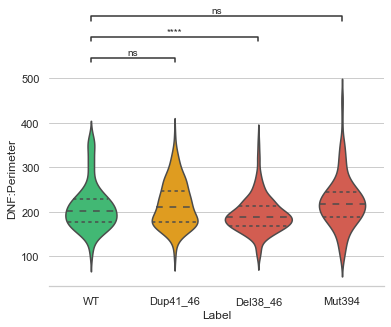

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.429e-01 stat=-9.496e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.526e-05 stat=4.360e+00
WT v.s. Mut394: t-test independent samples, P_val=5.202e-02 stat=-1.949e+00


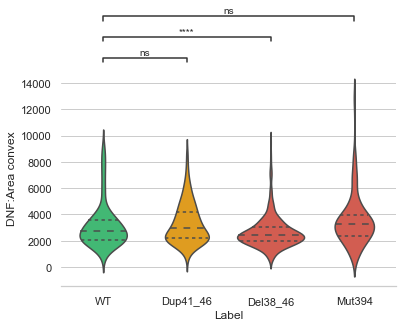

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.881e-01 stat=-1.318e+00
WT v.s. Del38_46: t-test independent samples, P_val=9.693e-01 stat=3.854e-02
WT v.s. Mut394: t-test independent samples, P_val=1.243e-03 stat=-3.252e+00


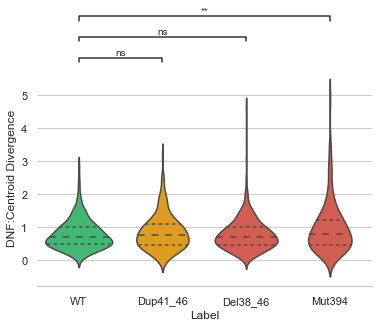

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.229e-01 stat=-1.221e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.038e-05 stat=4.294e+00
WT v.s. Mut394: t-test independent samples, P_val=4.461e-02 stat=-2.015e+00


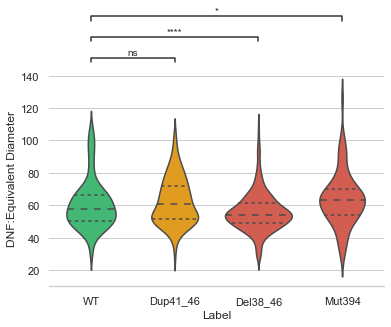

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.517e-01 stat=-7.533e-01
WT v.s. Del38_46: t-test independent samples, P_val=4.297e-01 stat=-7.902e-01
WT v.s. Mut394: t-test independent samples, P_val=5.055e-01 stat=-6.665e-01


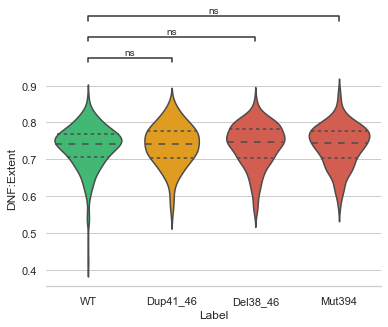

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.535e-01 stat=-4.492e-01
WT v.s. Del38_46: t-test independent samples, P_val=1.176e-05 stat=4.418e+00
WT v.s. Mut394: t-test independent samples, P_val=1.469e-01 stat=-1.453e+00


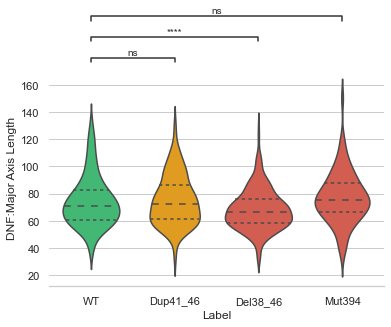

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.616e-02 stat=-1.778e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.802e-04 stat=3.573e+00
WT v.s. Mut394: t-test independent samples, P_val=2.548e-02 stat=-2.243e+00


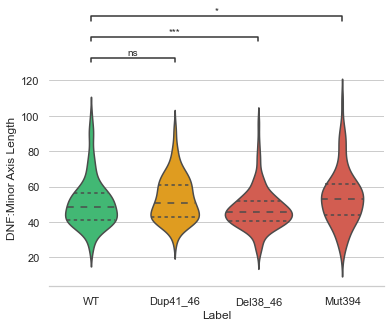

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.804e-02 stat=2.081e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.835e-01 stat=8.722e-01
WT v.s. Mut394: t-test independent samples, P_val=3.874e-01 stat=8.653e-01


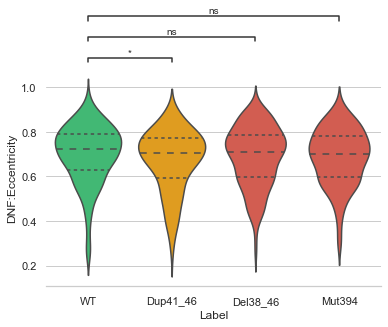

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.299e-01 stat=-9.754e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.232e-01 stat=-4.916e-01
WT v.s. Mut394: t-test independent samples, P_val=7.993e-01 stat=-2.545e-01


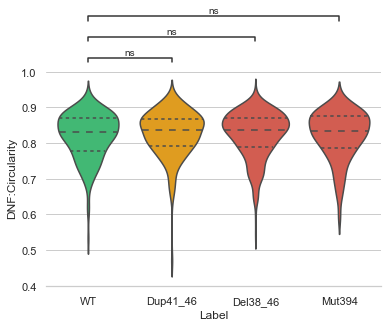

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.138e-02 stat=-2.160e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.521e-01 stat=-7.523e-01
WT v.s. Mut394: t-test independent samples, P_val=2.877e-01 stat=-1.065e+00


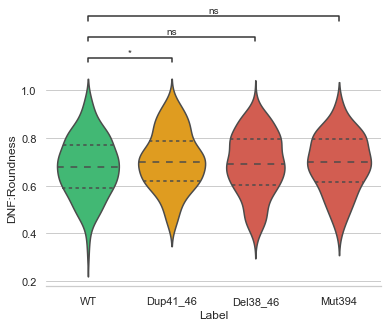

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.696e-02 stat=-1.716e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.231e-01 stat=-9.889e-01
WT v.s. Mut394: t-test independent samples, P_val=3.682e-01 stat=-9.008e-01


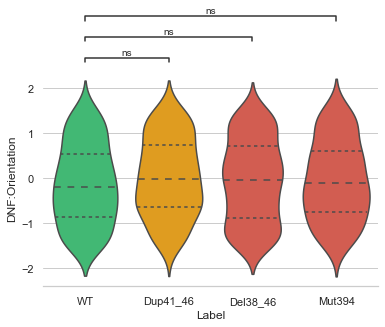

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=8.200e-01 stat=-2.276e-01
WT v.s. Del38_46: t-test independent samples, P_val=4.277e-01 stat=7.937e-01
WT v.s. Mut394: t-test independent samples, P_val=7.282e-01 stat=-3.478e-01


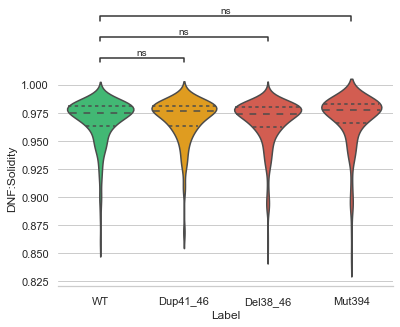

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.129e-01 stat=-8.196e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.767e-01 stat=-4.172e-01
WT v.s. Mut394: t-test independent samples, P_val=1.668e-01 stat=-1.385e+00


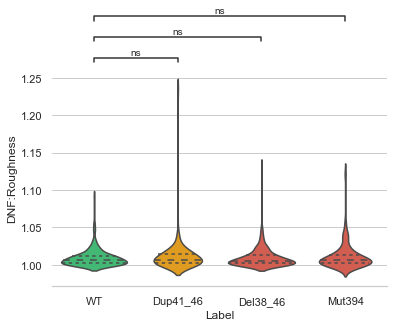

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.683e-02 stat=2.094e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.444e-01 stat=3.262e-01
WT v.s. Mut394: t-test independent samples, P_val=2.567e-01 stat=1.136e+00


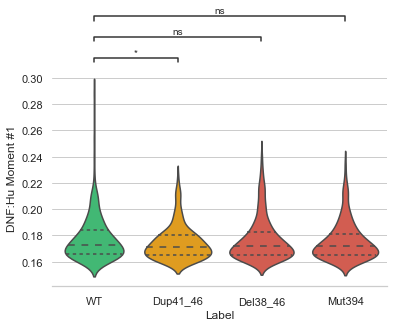

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.747e-02 stat=2.213e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.924e-01 stat=2.634e-01
WT v.s. Mut394: t-test independent samples, P_val=2.972e-01 stat=1.044e+00


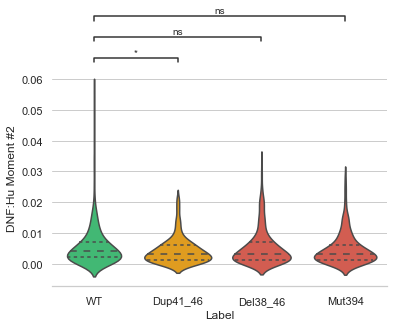

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.745e-01 stat=5.618e-01
WT v.s. Del38_46: t-test independent samples, P_val=3.782e-01 stat=8.818e-01
WT v.s. Mut394: t-test independent samples, P_val=1.670e-01 stat=1.384e+00


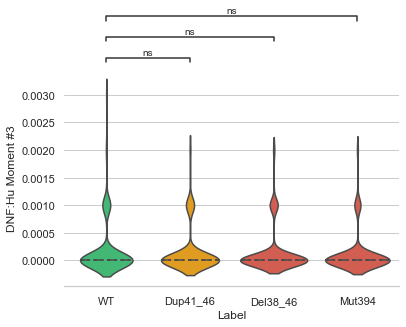

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.846e-08 stat=5.603e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.018e-02 stat=-2.578e+00
WT v.s. Mut394: t-test independent samples, P_val=4.854e-03 stat=2.833e+00


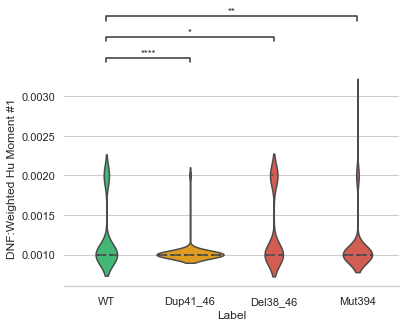

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan


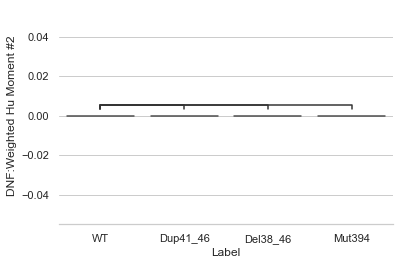

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan


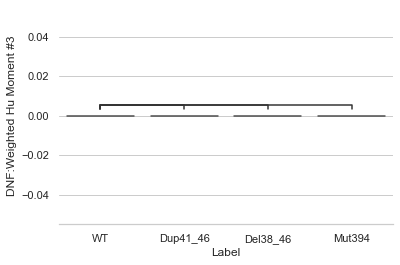

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.673e-01 stat=-5.725e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.915e-06 stat=4.536e+00
WT v.s. Mut394: t-test independent samples, P_val=1.052e-01 stat=-1.624e+00


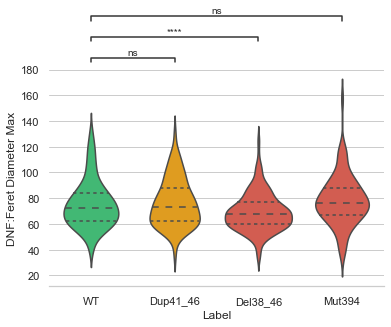

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.717e-01 stat=-1.101e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.303e-05 stat=4.396e+00
WT v.s. Mut394: t-test independent samples, P_val=4.812e-02 stat=-1.982e+00


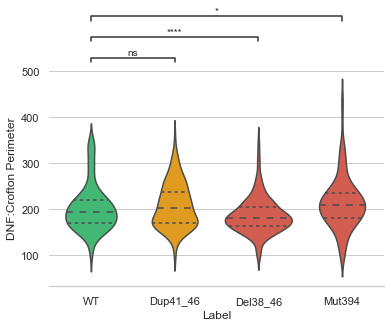

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=9.634e-14 stat=-7.708e+00
WT v.s. Del38_46: t-test independent samples, P_val=5.299e-21 stat=9.757e+00
WT v.s. Mut394: t-test independent samples, P_val=4.198e-02 stat=-2.040e+00


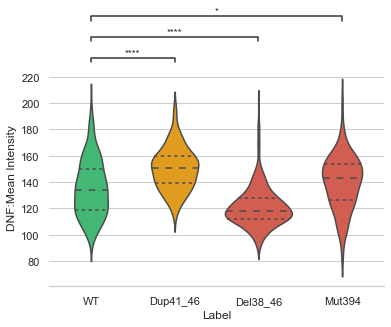

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.775e-19 stat=-9.497e+00
WT v.s. Del38_46: t-test independent samples, P_val=9.892e-01 stat=1.358e-02
WT v.s. Mut394: t-test independent samples, P_val=1.724e-02 stat=-2.392e+00


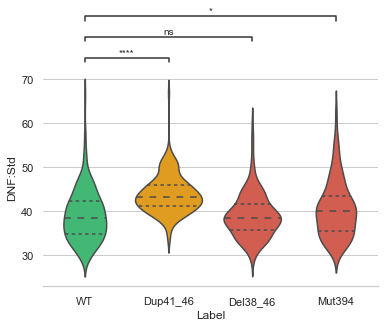

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=5.570e-17 stat=-8.748e+00
WT v.s. Del38_46: t-test independent samples, P_val=8.329e-01 stat=2.111e-01
WT v.s. Mut394: t-test independent samples, P_val=1.803e-02 stat=-2.375e+00


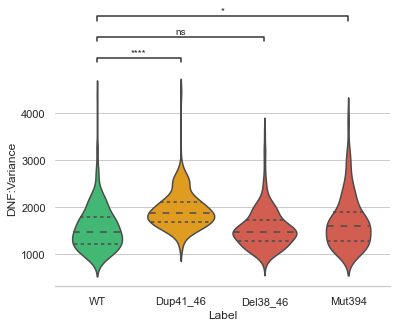

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.374e-06 stat=4.786e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.384e-11 stat=-6.752e+00
WT v.s. Mut394: t-test independent samples, P_val=4.419e-01 stat=7.697e-01


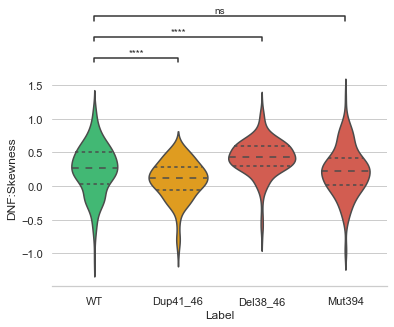

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.354e-26 stat=1.133e+01
WT v.s. Del38_46: t-test independent samples, P_val=6.579e-05 stat=-4.019e+00
WT v.s. Mut394: t-test independent samples, P_val=4.319e-03 stat=2.870e+00


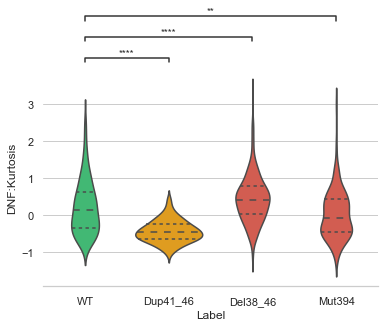

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Del38_46: t-test independent samples, P_val=nan stat=nan
WT v.s. Mut394: t-test independent samples, P_val=nan stat=nan


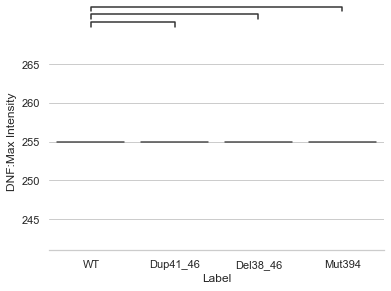

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.432e-03 stat=-3.051e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.755e-17 stat=8.713e+00
WT v.s. Mut394: t-test independent samples, P_val=3.552e-01 stat=-9.256e-01


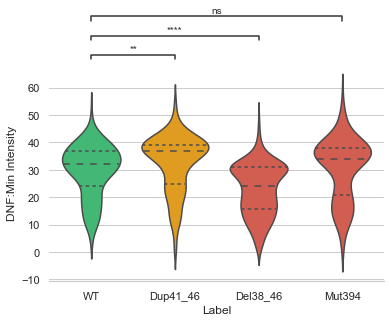

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.733e-05 stat=-4.112e+00
WT v.s. Del38_46: t-test independent samples, P_val=7.196e-01 stat=-3.592e-01
WT v.s. Mut394: t-test independent samples, P_val=1.049e-01 stat=-1.625e+00


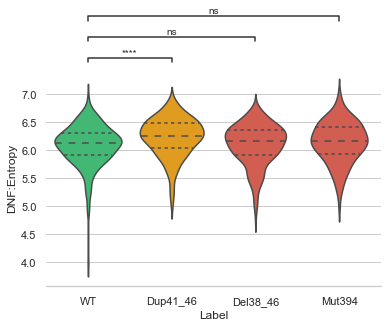

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.258e-01 stat=-3.510e-01
WT v.s. Del38_46: t-test independent samples, P_val=6.535e-06 stat=4.548e+00
WT v.s. Mut394: t-test independent samples, P_val=1.835e-01 stat=-1.332e+00


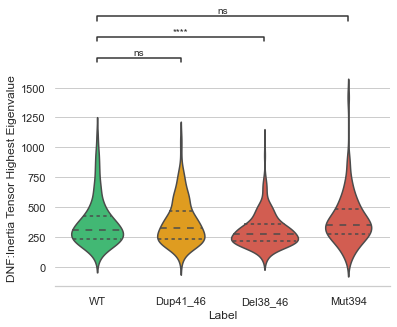

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.875e-01 stat=-1.320e+00
WT v.s. Del38_46: t-test independent samples, P_val=3.592e-04 stat=3.589e+00
WT v.s. Mut394: t-test independent samples, P_val=2.614e-02 stat=-2.233e+00


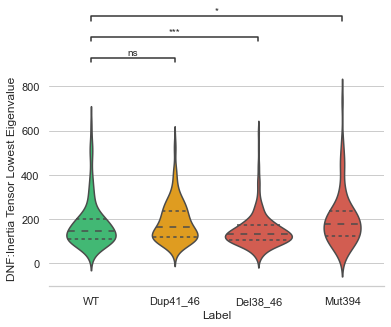

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.725e-01 stat=4.230e-01
WT v.s. Del38_46: t-test independent samples, P_val=4.180e-01 stat=8.105e-01
WT v.s. Mut394: t-test independent samples, P_val=6.778e-01 stat=4.157e-01


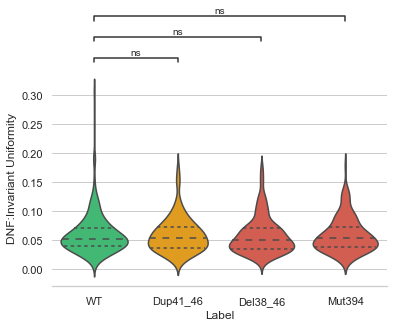

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.033e-03 stat=-3.105e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.004e-06 stat=4.941e+00
WT v.s. Mut394: t-test independent samples, P_val=5.785e-03 stat=-2.775e+00


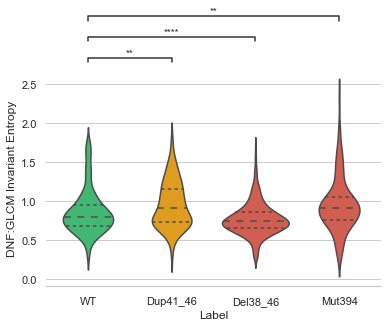

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.494e-04 stat=3.606e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.319e-06 stat=4.886e+00
WT v.s. Mut394: t-test independent samples, P_val=7.826e-04 stat=3.385e+00


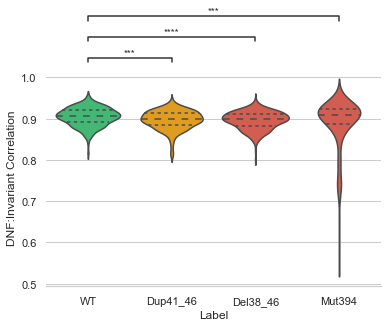

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.576e-28 stat=-1.184e+01
WT v.s. Del38_46: t-test independent samples, P_val=8.549e-03 stat=2.638e+00
WT v.s. Mut394: t-test independent samples, P_val=3.988e-05 stat=-4.155e+00


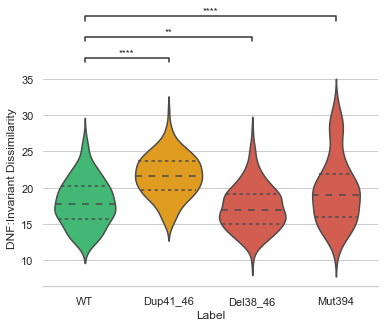

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.176e-22 stat=-1.033e+01
WT v.s. Del38_46: t-test independent samples, P_val=1.108e-02 stat=2.548e+00
WT v.s. Mut394: t-test independent samples, P_val=8.701e-06 stat=-4.506e+00


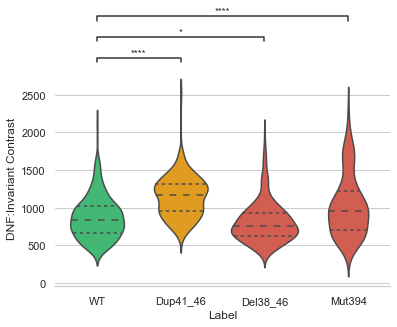

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.693e-02 stat=1.773e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.240e-01 stat=4.905e-01
WT v.s. Mut394: t-test independent samples, P_val=4.228e-01 stat=8.024e-01


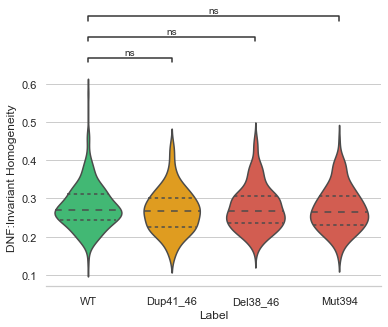

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=6.701e-01 stat=4.263e-01
WT v.s. Del38_46: t-test independent samples, P_val=3.366e-01 stat=9.616e-01
WT v.s. Mut394: t-test independent samples, P_val=6.973e-01 stat=3.892e-01


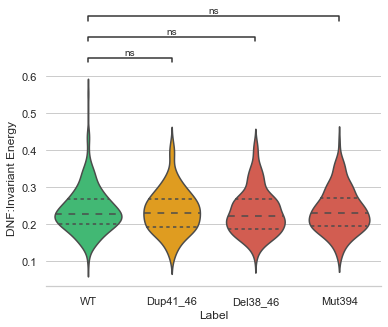

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=4.225e-01 stat=8.029e-01
WT v.s. Del38_46: t-test independent samples, P_val=5.383e-08 stat=-5.507e+00
WT v.s. Mut394: t-test independent samples, P_val=1.247e-01 stat=1.539e+00


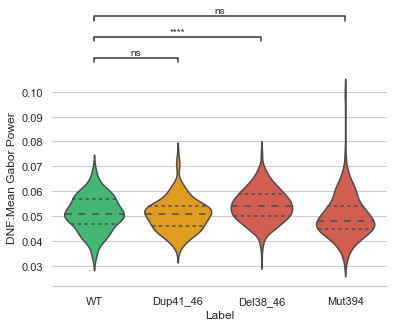

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.565e-20 stat=-9.802e+00
WT v.s. Del38_46: t-test independent samples, P_val=1.475e-01 stat=1.450e+00
WT v.s. Mut394: t-test independent samples, P_val=1.594e-01 stat=-1.410e+00


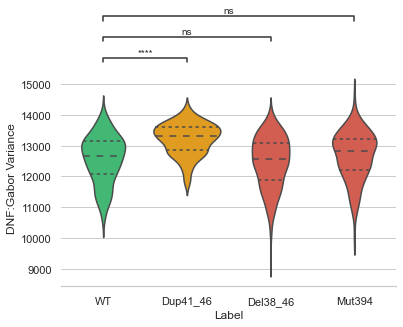

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.769e-16 stat=-8.532e+00
WT v.s. Del38_46: t-test independent samples, P_val=4.881e-01 stat=6.938e-01
WT v.s. Mut394: t-test independent samples, P_val=3.898e-01 stat=-8.610e-01


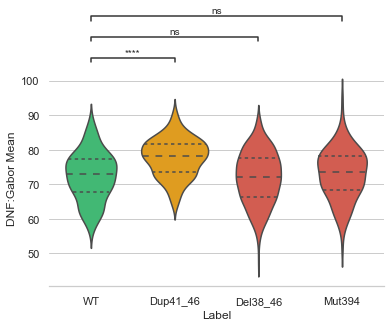

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=7.757e-08 stat=-5.471e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.323e-01 stat=1.196e+00
WT v.s. Mut394: t-test independent samples, P_val=6.450e-01 stat=-4.611e-01


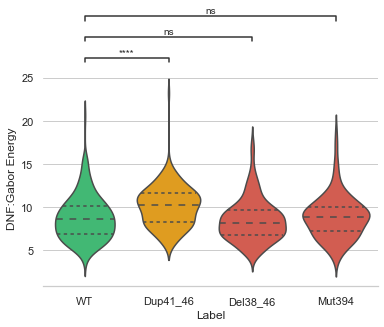

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=1.356e-17 stat=-8.936e+00
WT v.s. Del38_46: t-test independent samples, P_val=2.638e-02 stat=2.226e+00
WT v.s. Mut394: t-test independent samples, P_val=2.803e-01 stat=-1.081e+00


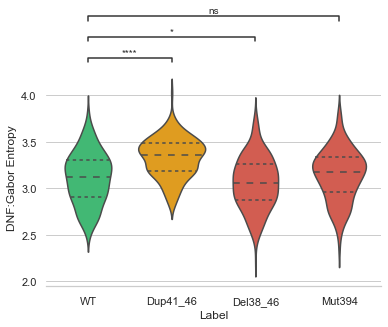

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=3.300e-38 stat=-1.436e+01
WT v.s. Del38_46: t-test independent samples, P_val=2.456e-10 stat=6.437e+00
WT v.s. Mut394: t-test independent samples, P_val=8.821e-10 stat=-6.282e+00


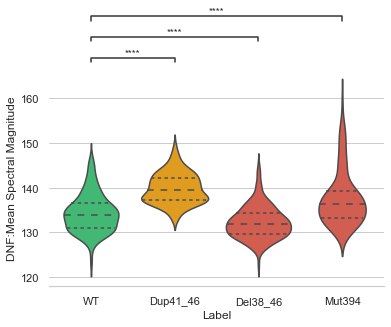

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

WT v.s. Dup41_46: t-test independent samples, P_val=2.962e-11 stat=-6.835e+00
WT v.s. Del38_46: t-test independent samples, P_val=6.006e-06 stat=-4.566e+00
WT v.s. Mut394: t-test independent samples, P_val=7.957e-07 stat=-5.017e+00


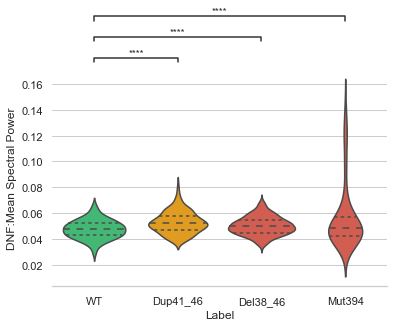

In [47]:
plot_violinplot_nuclei(df=NucleiResultsDF,save=True)